In [ ]:
!pip install super_gradients
!pip install numpy==1.22.0

In [ ]:
import os
import random
import shutil
import numpy as np
import pandas as pd
import cv2
import yaml
import matplotlib.pyplot as plt
import glob
from sklearn.model_selection import train_test_split
from tqdm.notebook import tqdm

In [ ]:
import torch
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val
from super_gradients.training import models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback

# setting parameters

In [ ]:
DIR = "/kaggle/working/datasets/cars/"
IMAGES = DIR +"images/"
LABELS = DIR +"labels/"

TRAIN = "/kaggle/input/car-object-detection/data/training_images"
TEST = "/kaggle/input/car-object-detection/data/testing_images"

In [ ]:
df = pd.read_csv("/kaggle/input/car-object-detection/data/train_solution_bounding_boxes (1).csv")
df

# setting dataset

In [ ]:
files = list(df.image.unique())

files_train, files_valid = train_test_split(files, test_size = 0.2)

In [ ]:
# !rm -r /kaggle/working/dataset

In [ ]:
# make directories
os.makedirs(IMAGES+"train", exist_ok=True)
os.makedirs(LABELS+"train", exist_ok=True)
os.makedirs(IMAGES+"valid", exist_ok=True)
os.makedirs(LABELS+"valid", exist_ok=True)

In [ ]:
train_filename = set(files_train)
valid_filename = set(files_valid)
for file in glob.glob(TRAIN+"/*"):
    fname =os.path.basename(file)
    if fname in train_filename:
        shutil.copy(file, IMAGES+"train")
    elif fname in valid_filename:
        shutil.copy(file, IMAGES+"valid")

In [ ]:
for _, row in df.iterrows():    
    image_file = row['image']
    class_id = "0"
    x = row['xmin']
    y = row['ymin']
    width = row['xmax'] - row['xmin']
    height = row['ymax'] - row['ymin']

    x_center = x + (width / 2)
    y_center = y + (height / 2)
    x_center /= 676
    y_center /= 380
    width /= 676
    height /= 380

    if image_file in train_filename:   
        annotation_file = os.path.join(LABELS) + "train/" + image_file.replace('.jpg', '.txt')
    else:
        annotation_file = os.path.join(LABELS) + "valid/" + image_file.replace('.jpg', '.txt')
        
    with open(annotation_file, 'a') as ann_file:
        ann_file.write(f"{class_id} {x_center} {y_center} {width} {height}\n")

# setup yaml file

In [ ]:
%%writefile dataset.yaml
# Path
path: ./cars
train: images/train
val: images/valid

# Classes
nc: 1
names: ['car']

# disable wandb

In [ ]:
# # disable wandb
# import wandb
# wandb.init(mode="disabled")

## Dataset

In [ ]:
dataset_params = {
    'data_dir':'/kaggle/working/datasets/cars',
    'train_images_dir':'images/train',
    'train_labels_dir':'labels/train',
    'val_images_dir':'images/valid',
    'val_labels_dir':'labels/valid',
    'test_images_dir':'images/valid',
    'test_labels_dir':'labels/valid',
    'classes': ['car']    
}

In [ ]:
MODEL_ARCH = 'yolo_nas_l'
DEVICE = 'cuda' if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 8
MAX_EPOCHS = 10
CHECKPOINT_DIR = f'/kaggle/working'
EXPERIMENT_NAME = f'yolo_nas_car'

In [ ]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 1
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 1
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 1
    }
)

In [ ]:
train_data.dataset.transforms

In [ ]:
train_data.dataset.plot()

## Get Model

In [ ]:
model = models.get(
    MODEL_ARCH, 
    num_classes=len(dataset_params['classes']), 
    pretrained_weights="coco"
)

## Train

In [ ]:
train_params = {
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    "max_epochs": MAX_EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

In [ ]:
from super_gradients.training import Trainer

trainer = Trainer(experiment_name=EXPERIMENT_NAME, ckpt_root_dir=CHECKPOINT_DIR)

In [ ]:
trainer.train(model=model, 
              training_params=train_params, 
              train_loader=train_data, 
              valid_loader=val_data)

## inference

In [ ]:
file = glob.glob(f"{CHECKPOINT_DIR}/{EXPERIMENT_NAME}/*/average_model.pth")
file

In [ ]:
best_model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    checkpoint_path=file[0]
).to(DEVICE)

In [ ]:
# display result
files = glob.glob(f"{dataset_params['data_dir']}/{dataset_params['test_images_dir']}/*")
for i in range(0, 30, 3):
    print(files[i])
    img = files[i]
    best_model.predict(img).show()

In [125]:
!pip install moviepy
!pip install moviepy --upgrade
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from extract import *
from IPython.display import display, Image

car_detection_model = best_model
from moviepy import editor
import moviepy

In [143]:
def visualize_predictions(image, picture_to_be_modified, best_model):
    
    # Create a figure and axis
    fig, ax = plt.subplots(1)
    prediction = best_model.predict(image)
    pred = prediction[0].prediction

    # Extract prediction information
    bboxes_xyxy = pred.bboxes_xyxy
    confidence = pred.confidence
    labels = pred.labels

    # Convert bboxes from xyxy format to xywh format
    bboxes_xywh = np.zeros_like(bboxes_xyxy)
    bboxes_xywh[:, 0] = (bboxes_xyxy[:, 0] + bboxes_xyxy[:, 2]) / 2  # x center
    bboxes_xywh[:, 1] = (bboxes_xyxy[:, 1] + bboxes_xyxy[:, 3]) / 2  # y center
    bboxes_xywh[:, 2] = bboxes_xyxy[:, 2] - bboxes_xyxy[:, 0]  # width
    bboxes_xywh[:, 3] = bboxes_xyxy[:, 3] - bboxes_xyxy[:, 1]  # height

    # Iterate over each prediction and draw the bounding box
    for i in range(len(bboxes_xywh)):
        bbox = bboxes_xywh[i]
        label = int(labels[i])
        confidence_score = float(confidence[i])

        # Create a Rectangle patch
        rect = patches.Rectangle(
            (bbox[0] - bbox[2] / 2, bbox[1] - bbox[3] / 2),  # (x, y)
            bbox[2],  # width
            bbox[3],  # height
            linewidth=2,
            edgecolor='r',
            facecolor='none',
        )

        # Add the patch to the Axes
        ax.add_patch(rect)
        text_x = bbox[0] - bbox[2] / 2
        text_y = bbox[1] + bbox[3] / 2
        ax.text(text_x, text_y, f'Car {confidence_score:.2f}', color='r')

    # Overlay the modified image with bounding boxes on the original image
    ax.imshow(picture_to_be_modified)

    # Do not show axes
    ax.axis('off')

    # Save the modified image with bounding boxes
    fig.canvas.draw()
    modified_image = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    modified_image = modified_image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return modified_image

def frame_processor(image, car_model):
    """
    Process the input frame to detect lane lines.
    Parameters:
        image: image of a road where one wants to detect lane lines
        (we will be passing frames of video to this function)
    """
    # Grayscale
    grayed_img = grayscale(image)
    
    #Before detecting the edges, we should apply a gaussian filter to soften noise
    gauss_img = gaussian_blur(grayed_img, 5)
    
    #Now we apply the Canny Edge detector on the grayed image:
    canny_edges_img = canny(gauss_img, 40, 80)
    
    #Now we apply a region mask to focus only in our region of interest.
    #The region of interest will be defined by a trapezoid with two vertex in the bottom corners
    #of the image and the other two in the 'horizon' area of the road aprox.
    dims= canny_edges_img.shape
    top_vertex_l = (dims[1]*.45,dims[0]*.62)
    top_vertex_r = (dims[1]*.55,dims[0]*.62)
    vertices = np.array([[(0,dims[0]),top_vertex_l,top_vertex_r,(dims[1],dims[0])]], dtype =np.int32)
    masked_img = region_of_interest(canny_edges_img, vertices)
    
    #Finally we apply the Hough transform to detect the lines in the image.
    lines_img = hough_lines(masked_img,1,np.pi/180,40,30,200)
    result = weighted_img(lines_img,image)
    
    result = visualize_predictions(image, result, car_model)
    # Convert the result image to bytes
    _, img_bytes = cv2.imencode('.png', result)
    
    # Display the image within the loop
    display(Image(data=img_bytes))
    
    return result

In [117]:
!mkdir /kaggle/working/vid1_frames

0/486
Cannot draw slope line !


[2023-12-04 19:33:17] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


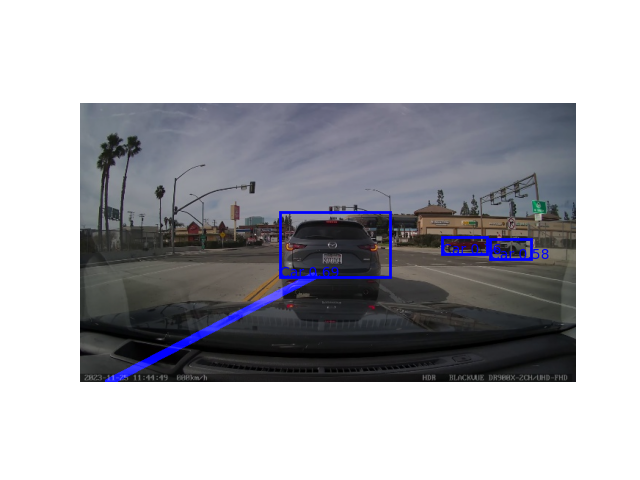

[2023-12-04 19:33:18] WARNING - warnings.py - /tmp/ipykernel_32/1282767411.py:50: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  modified_image = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')

[2023-12-04 19:33:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


Cannot draw slope line !


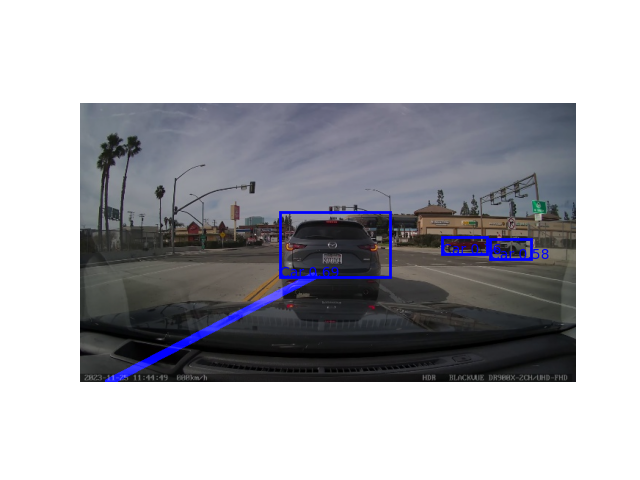

1/486
Cannot draw slope line !


[2023-12-04 19:33:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


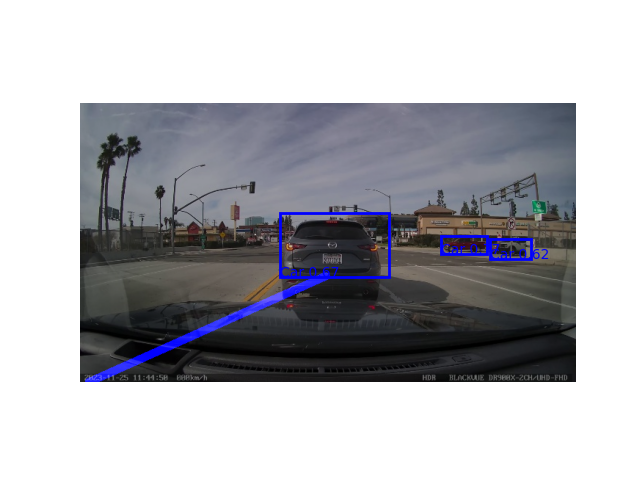

Cannot draw slope line !


[2023-12-04 19:33:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


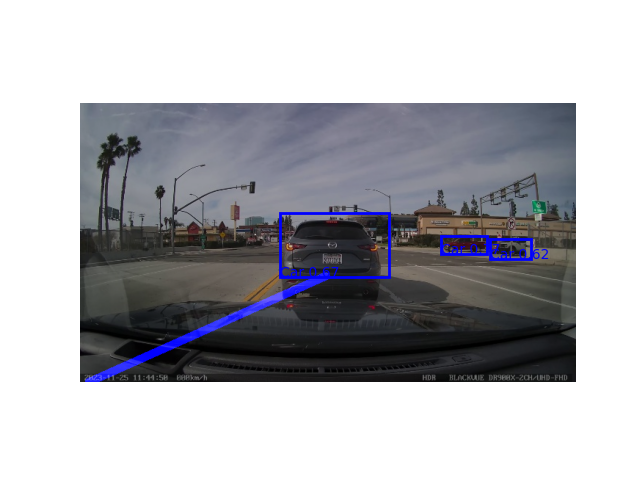

2/486
Cannot draw slope line !


[2023-12-04 19:33:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


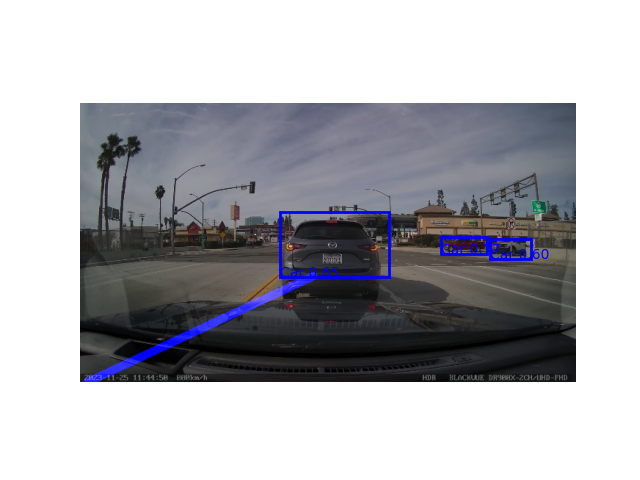

Cannot draw slope line !


[2023-12-04 19:33:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


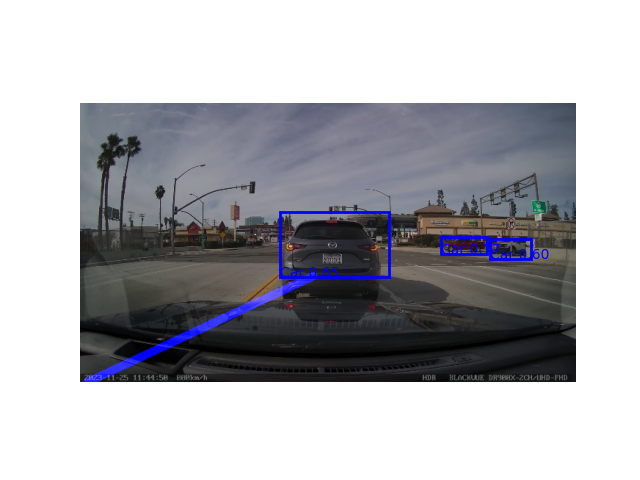

3/486
Cannot draw slope line !


[2023-12-04 19:33:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


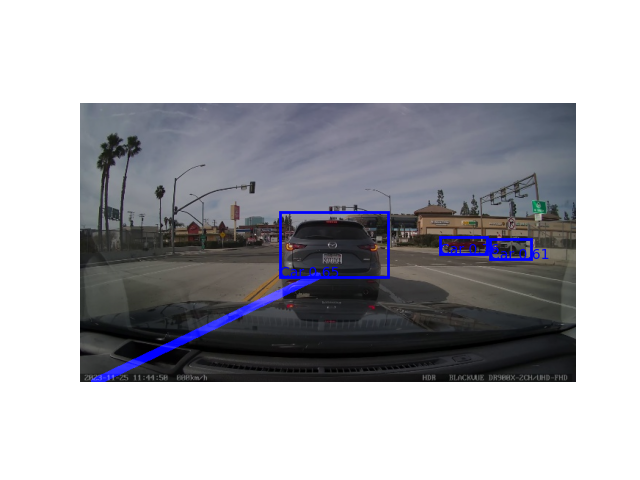

Cannot draw slope line !


[2023-12-04 19:33:20] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


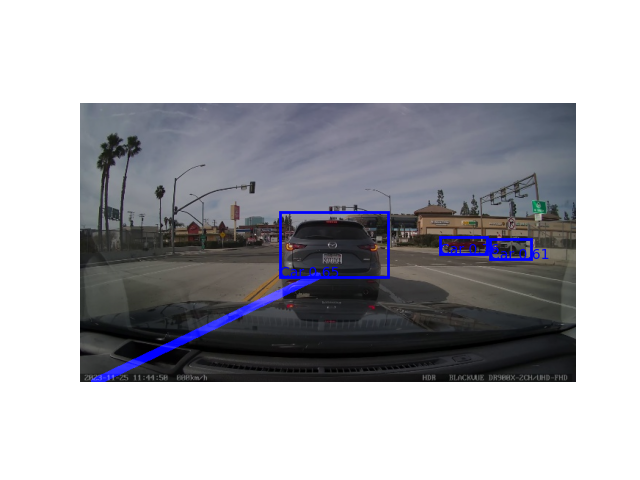

4/486
Cannot draw slope line !


[2023-12-04 19:33:20] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


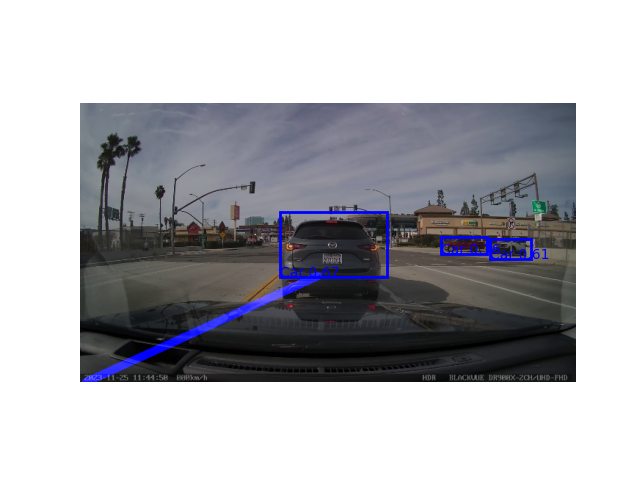

Cannot draw slope line !


[2023-12-04 19:33:20] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


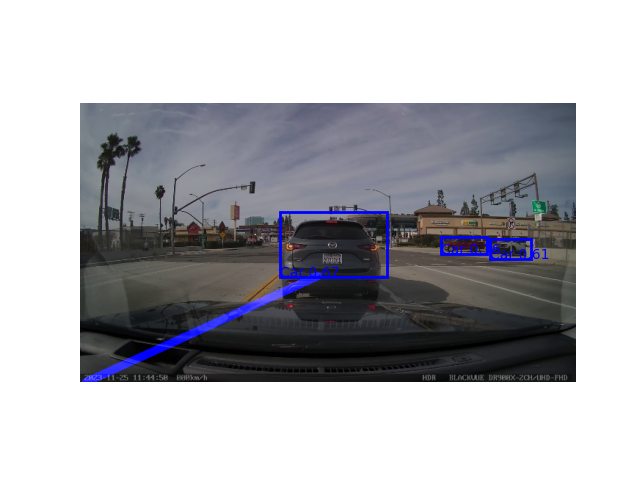

5/486
Cannot draw slope line !


[2023-12-04 19:33:21] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


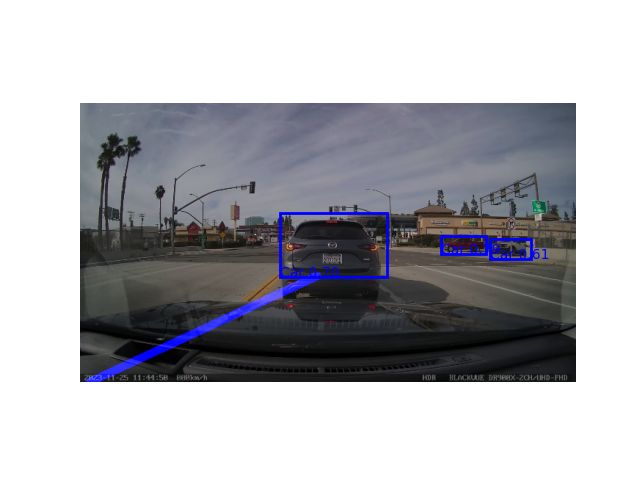

Cannot draw slope line !


[2023-12-04 19:33:21] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


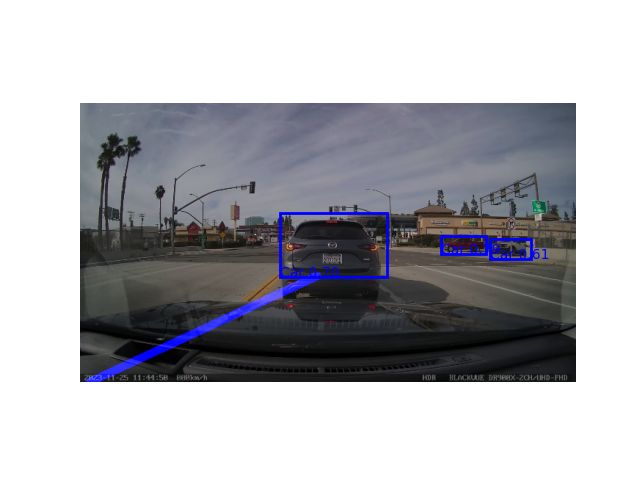

6/486
Cannot draw slope line !


[2023-12-04 19:33:21] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


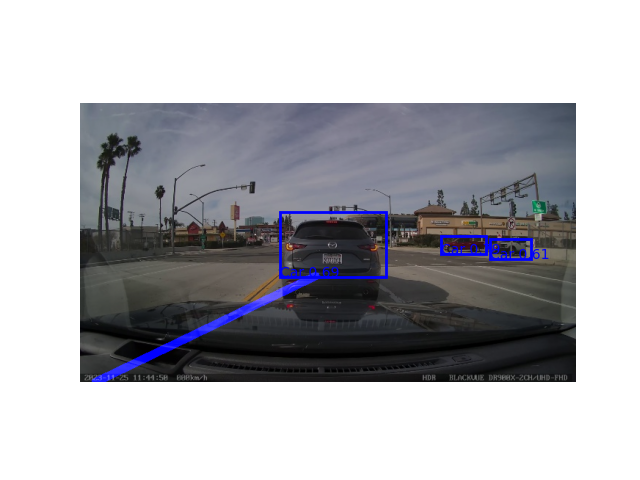

Cannot draw slope line !


[2023-12-04 19:33:22] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


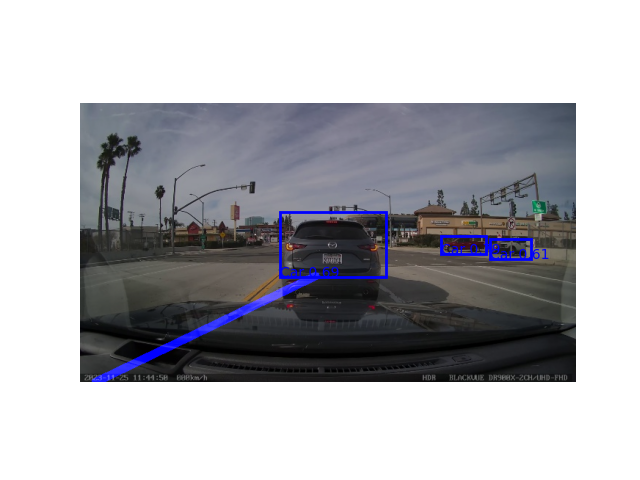

7/486
Cannot draw slope line !


[2023-12-04 19:33:22] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


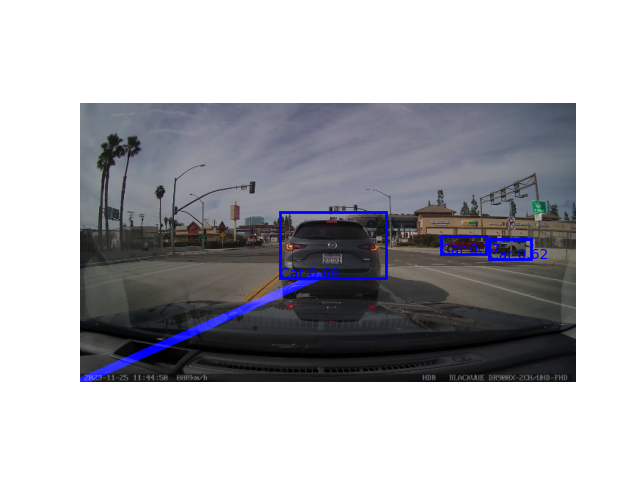

Cannot draw slope line !


[2023-12-04 19:33:23] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


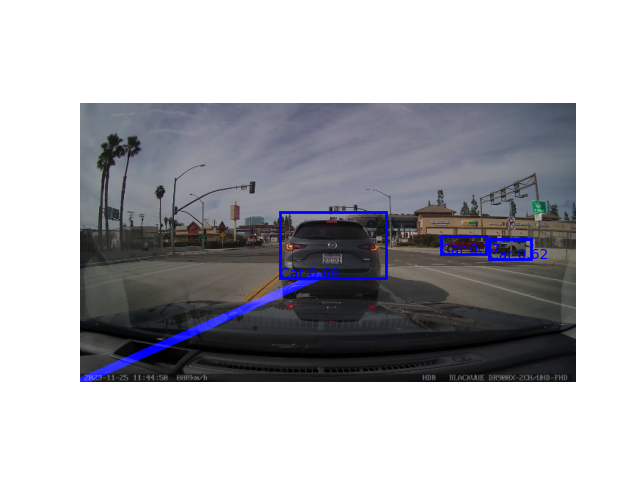

8/486
Cannot draw slope line !


[2023-12-04 19:33:23] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


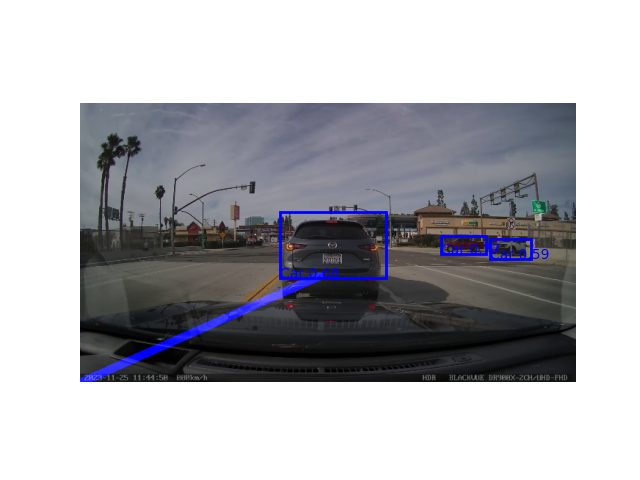

Cannot draw slope line !


[2023-12-04 19:33:23] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


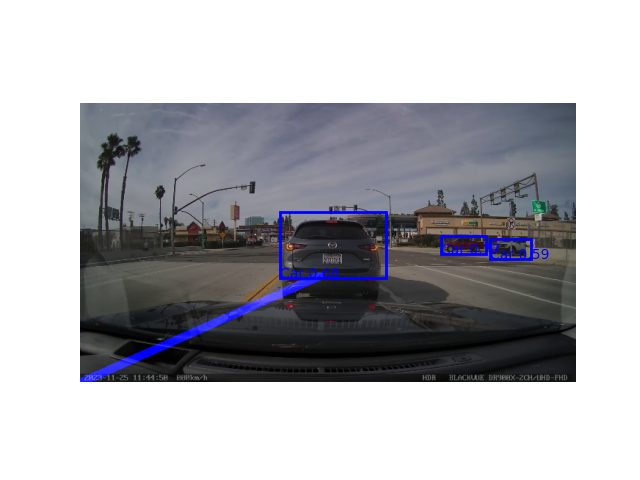

9/486
Cannot draw slope line !


[2023-12-04 19:33:24] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


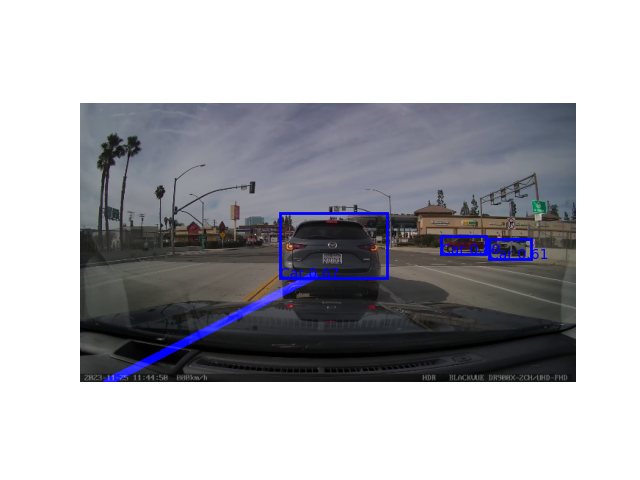

Cannot draw slope line !


[2023-12-04 19:33:25] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


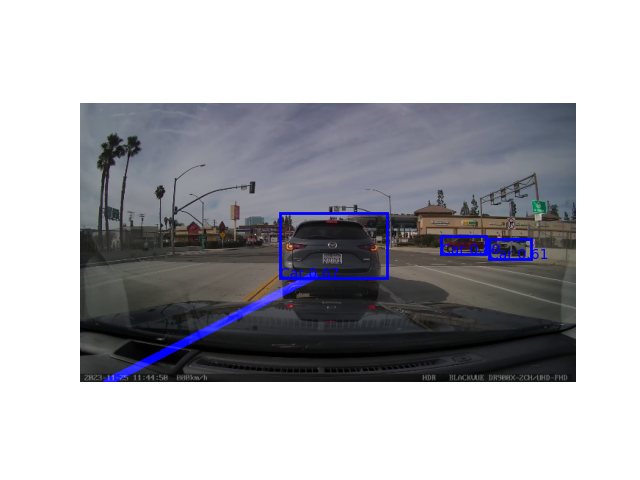

10/486
Cannot draw slope line !


[2023-12-04 19:33:25] WARNING - warnings.py - /tmp/ipykernel_32/1282767411.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1)

[2023-12-04 19:33:25] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


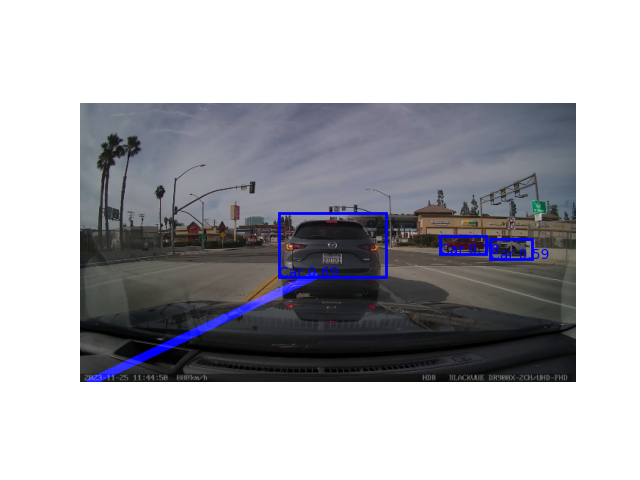

Cannot draw slope line !


[2023-12-04 19:33:25] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


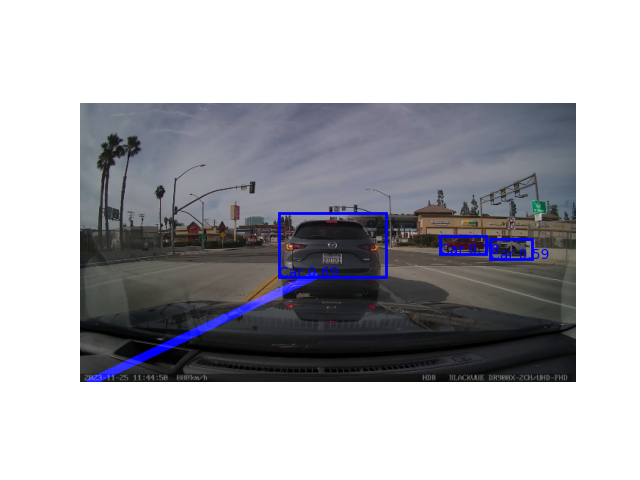

11/486
Cannot draw slope line !


[2023-12-04 19:33:26] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


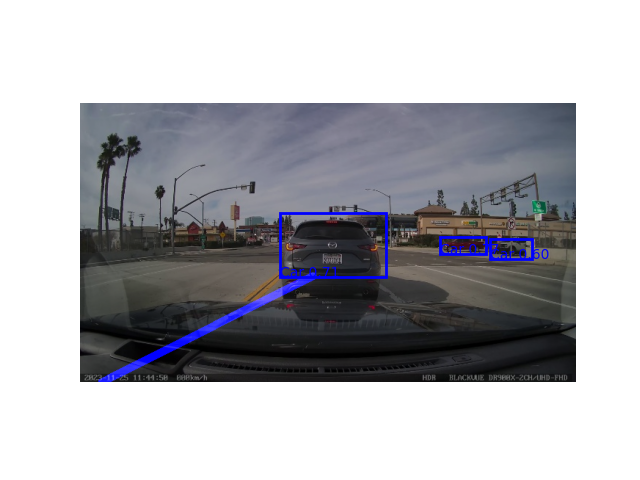

Cannot draw slope line !


[2023-12-04 19:33:26] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


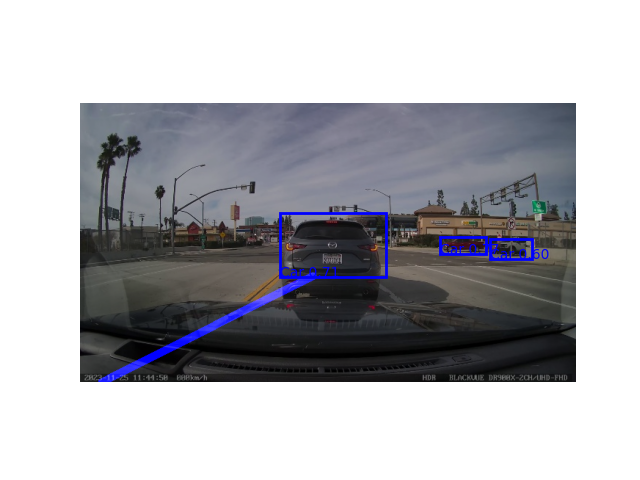

12/486
Cannot draw slope line !


[2023-12-04 19:33:26] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


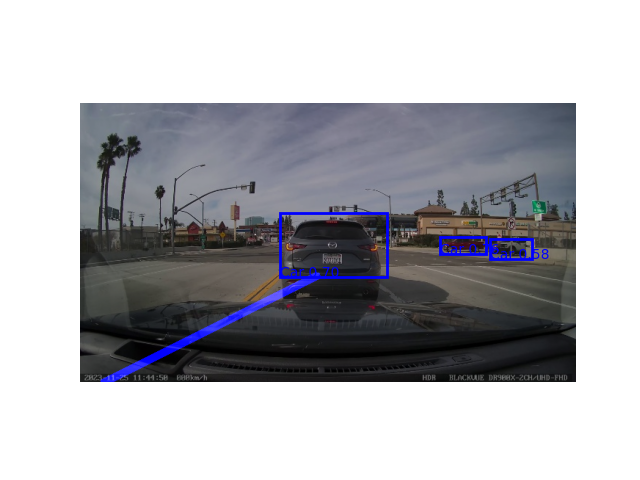

Cannot draw slope line !


[2023-12-04 19:33:27] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


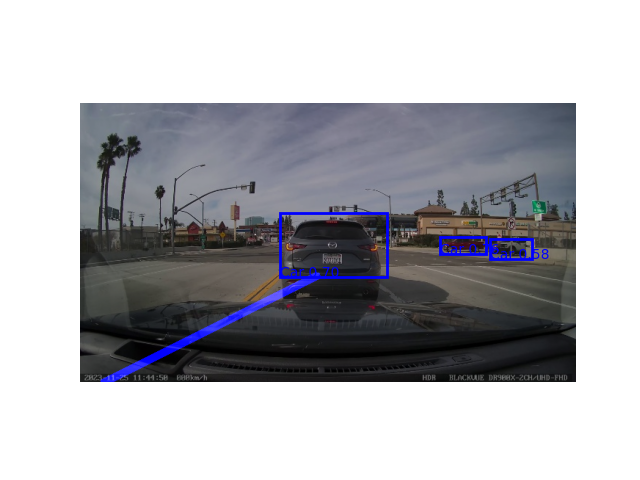

13/486
Cannot draw slope line !


[2023-12-04 19:33:27] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


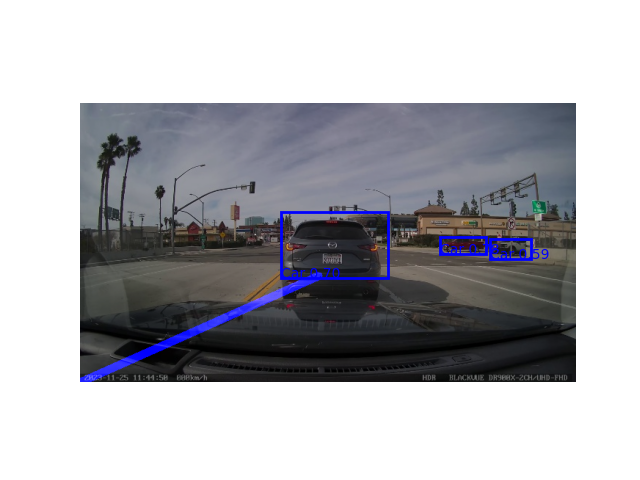

Cannot draw slope line !


[2023-12-04 19:33:27] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


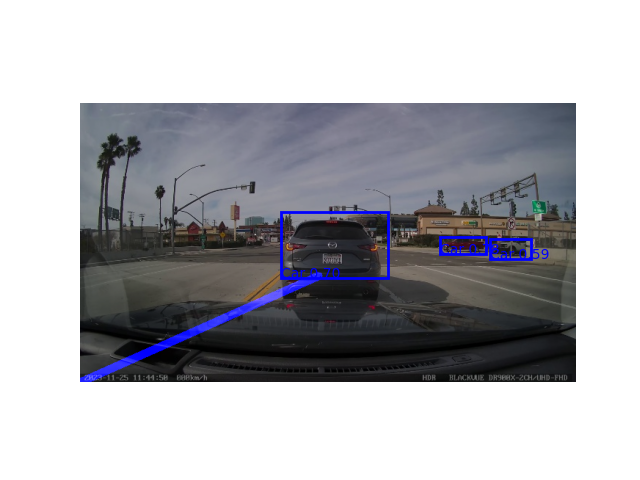

14/486
Cannot draw slope line !


[2023-12-04 19:33:28] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


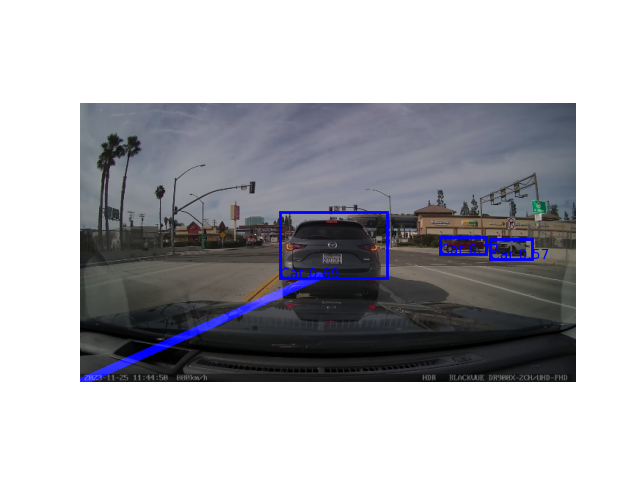

Cannot draw slope line !


[2023-12-04 19:33:28] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


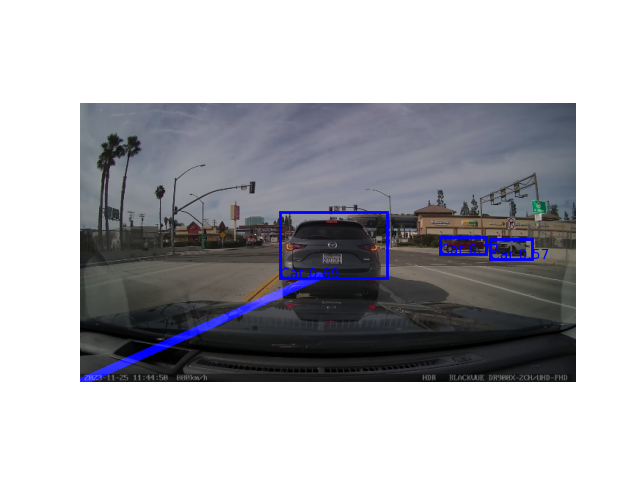

15/486
Cannot draw slope line !


[2023-12-04 19:33:28] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


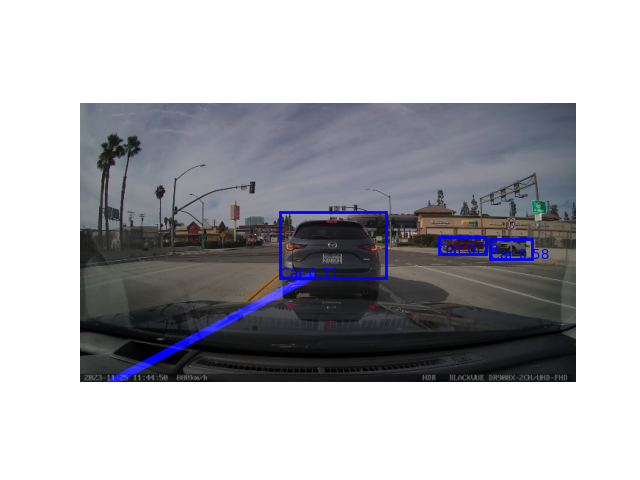

Cannot draw slope line !


[2023-12-04 19:33:29] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


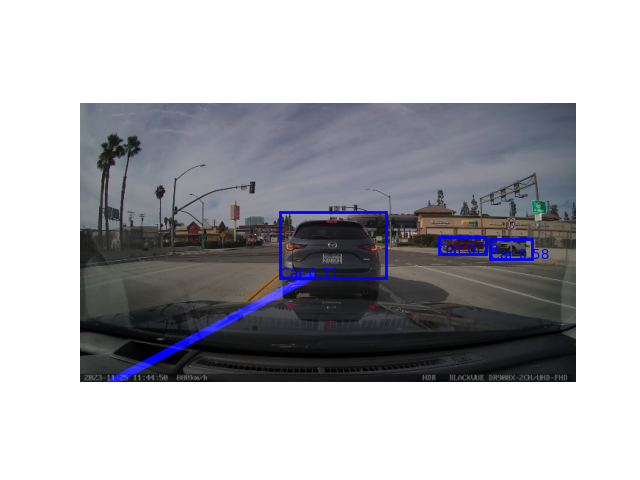

16/486
Cannot draw slope line !


[2023-12-04 19:33:29] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


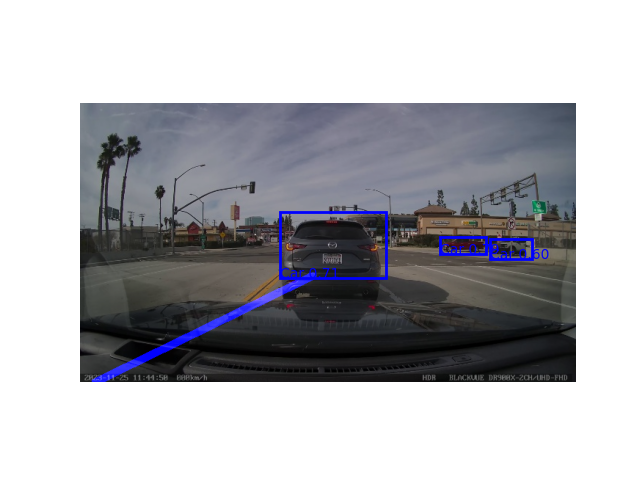

Cannot draw slope line !


[2023-12-04 19:33:29] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


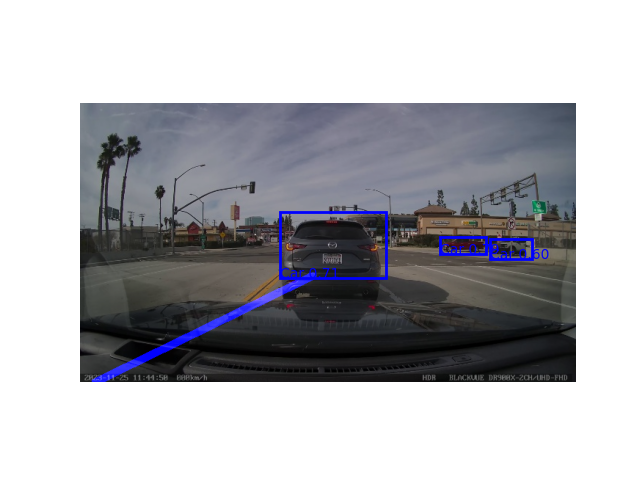

17/486
Cannot draw slope line !


[2023-12-04 19:33:30] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


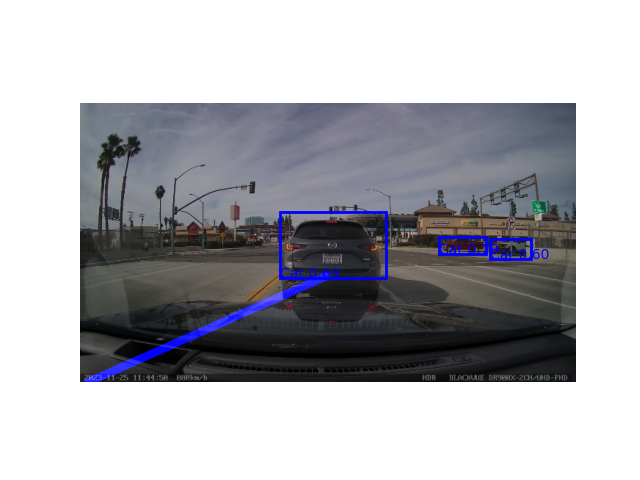

Cannot draw slope line !


[2023-12-04 19:33:30] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


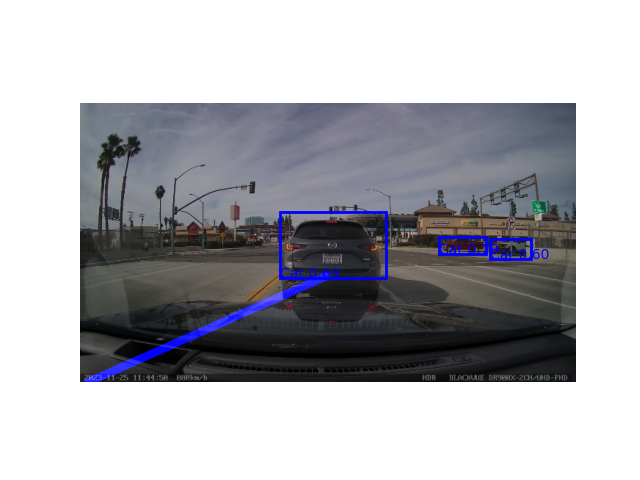

18/486
Cannot draw slope line !


[2023-12-04 19:33:31] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


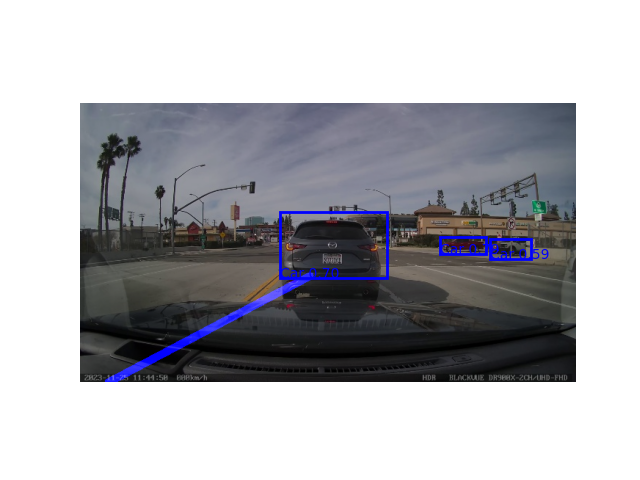

Cannot draw slope line !


[2023-12-04 19:33:31] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


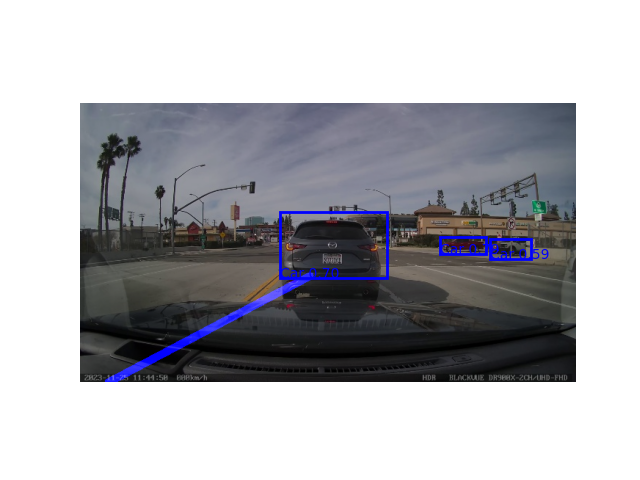

19/486
Cannot draw slope line !


[2023-12-04 19:33:31] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


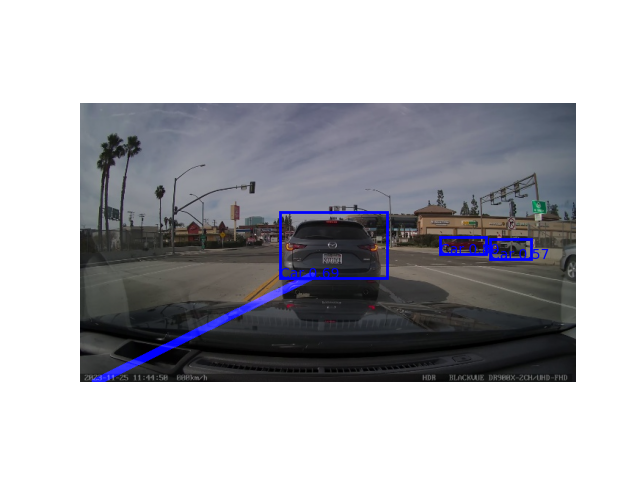

Cannot draw slope line !


[2023-12-04 19:33:32] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


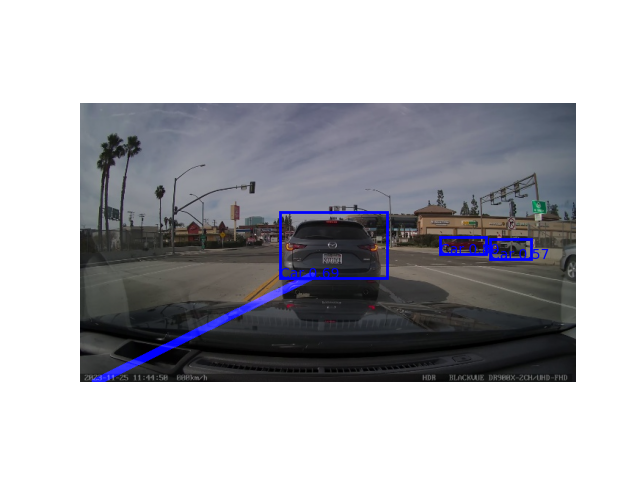

20/486
Cannot draw slope line !


[2023-12-04 19:33:32] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


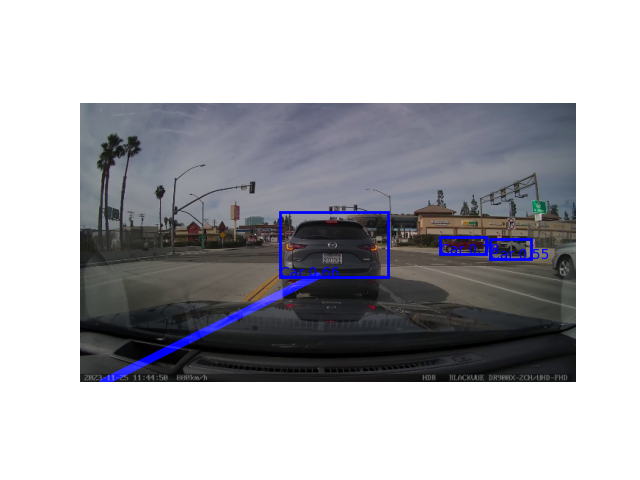

Cannot draw slope line !


[2023-12-04 19:33:32] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


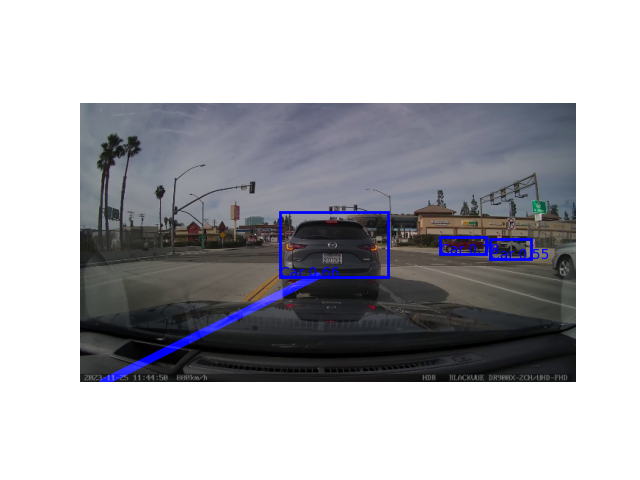

21/486
Cannot draw slope line !


[2023-12-04 19:33:33] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


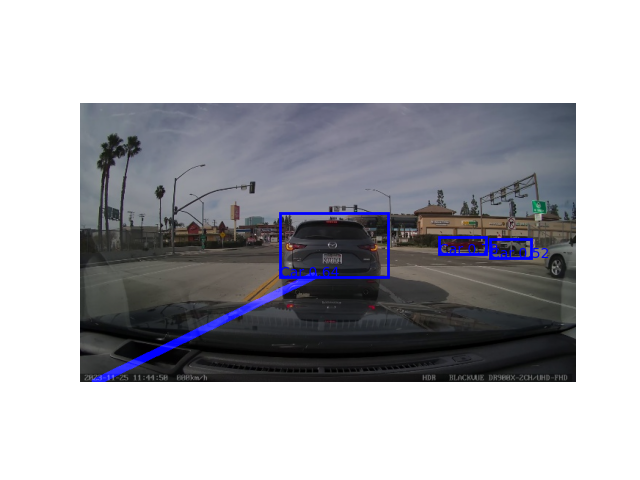

Cannot draw slope line !


[2023-12-04 19:33:34] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


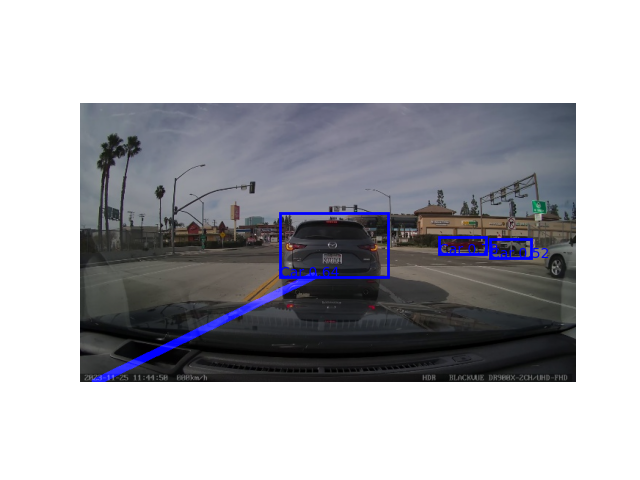

22/486
Cannot draw slope line !


[2023-12-04 19:33:34] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


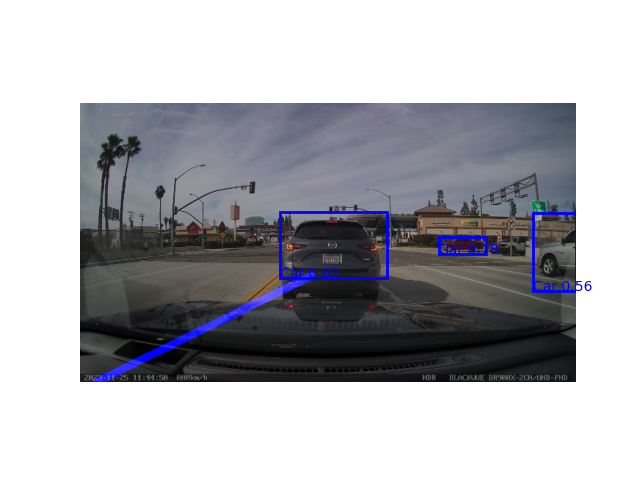

Cannot draw slope line !


[2023-12-04 19:33:34] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


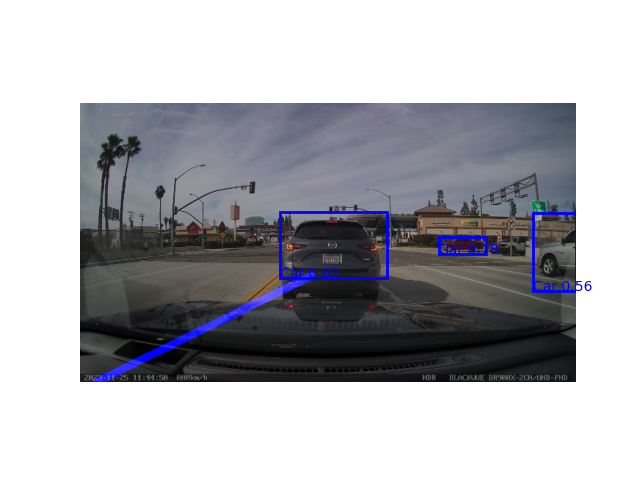

23/486
Cannot draw slope line !


[2023-12-04 19:33:35] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


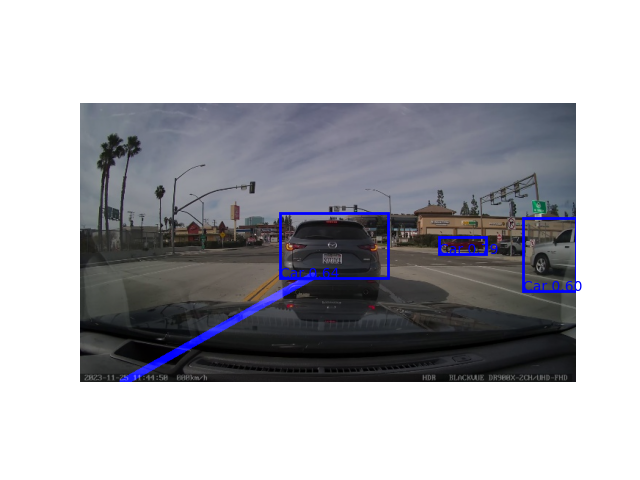

Cannot draw slope line !


[2023-12-04 19:33:35] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


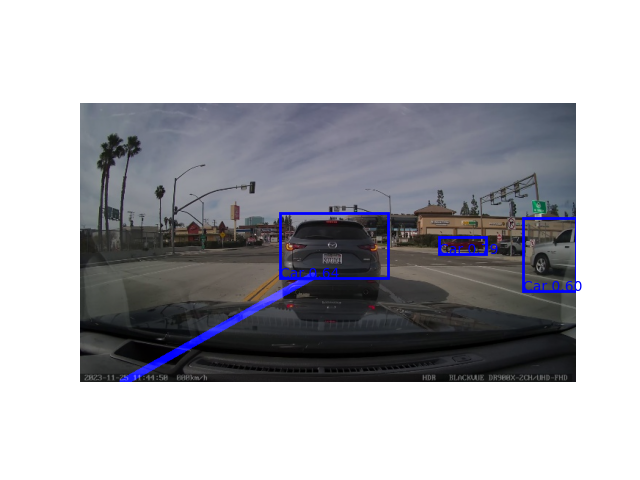

24/486
Cannot draw slope line !


[2023-12-04 19:33:35] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


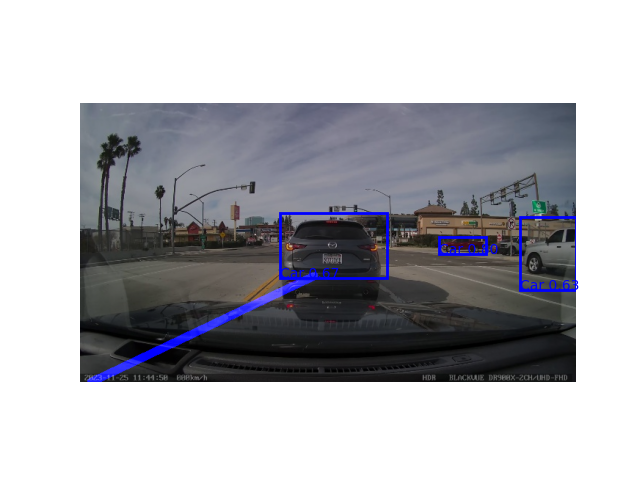

Cannot draw slope line !


[2023-12-04 19:33:36] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


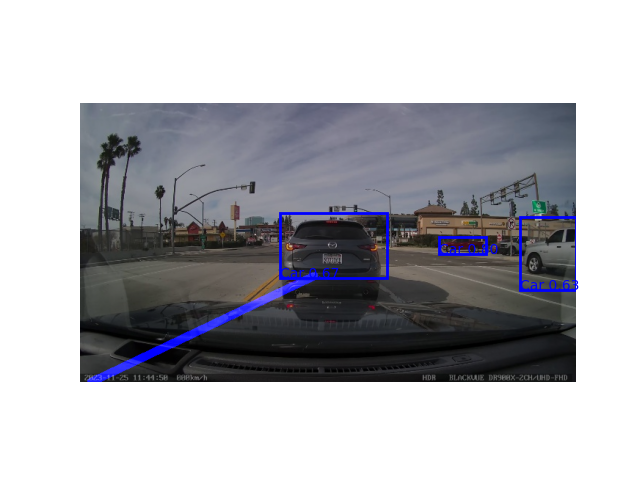

25/486
Cannot draw slope line !


[2023-12-04 19:33:36] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


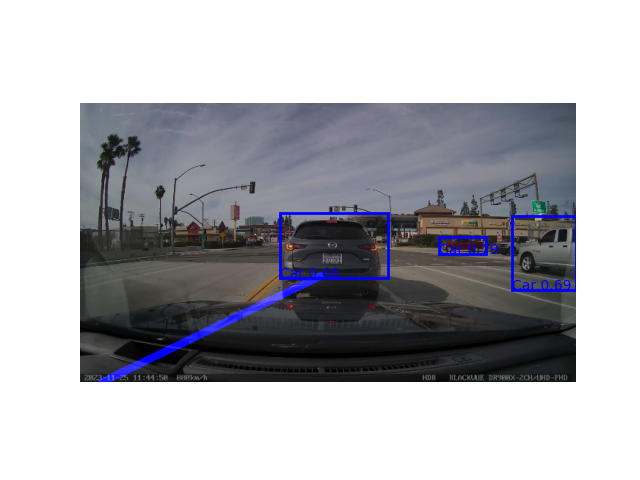

Cannot draw slope line !


[2023-12-04 19:33:36] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


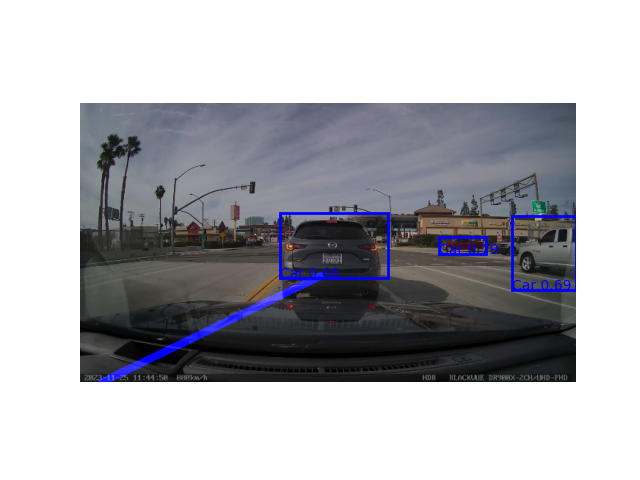

26/486
Cannot draw slope line !


[2023-12-04 19:33:37] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


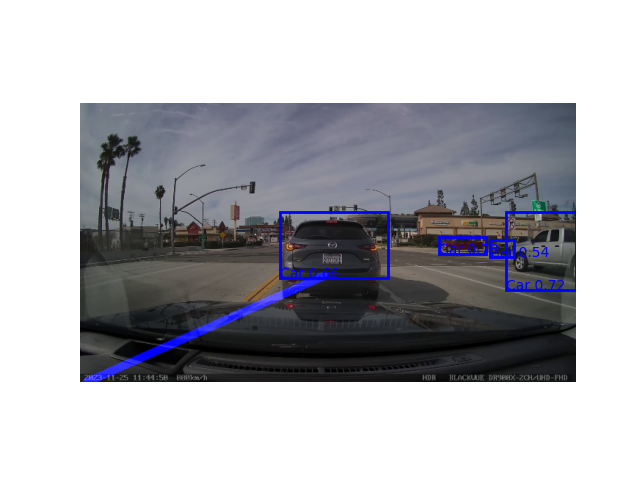

Cannot draw slope line !


[2023-12-04 19:33:37] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


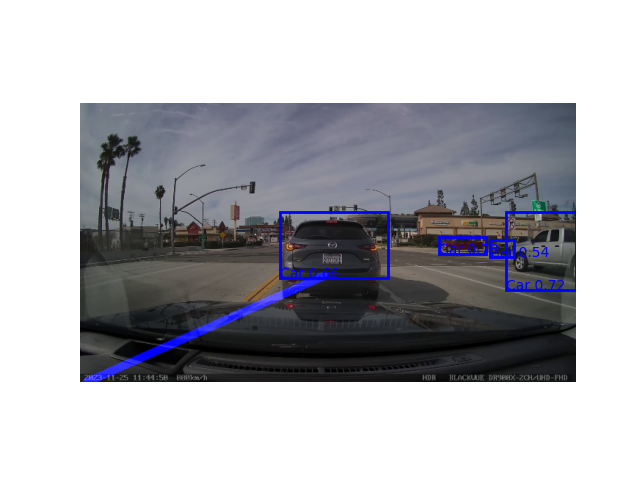

27/486
Cannot draw slope line !


[2023-12-04 19:33:37] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


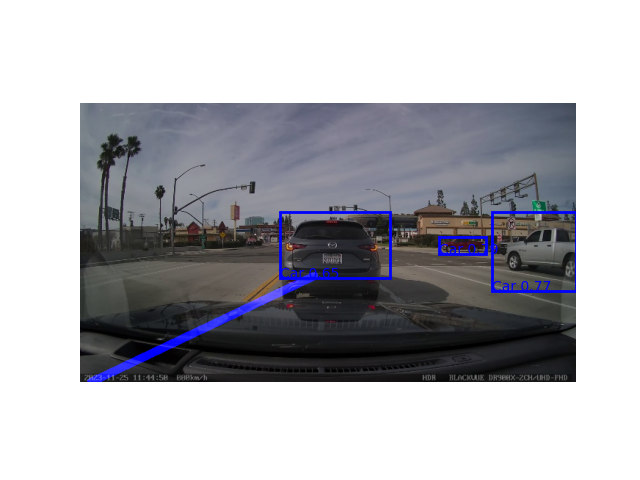

Cannot draw slope line !


[2023-12-04 19:33:38] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


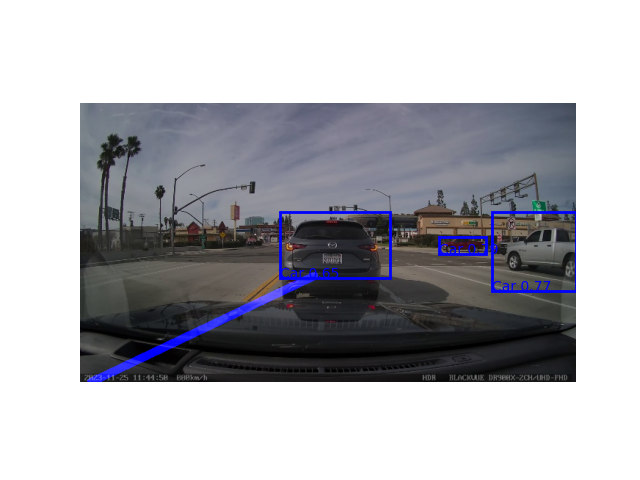

28/486
Cannot draw slope line !


[2023-12-04 19:33:38] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


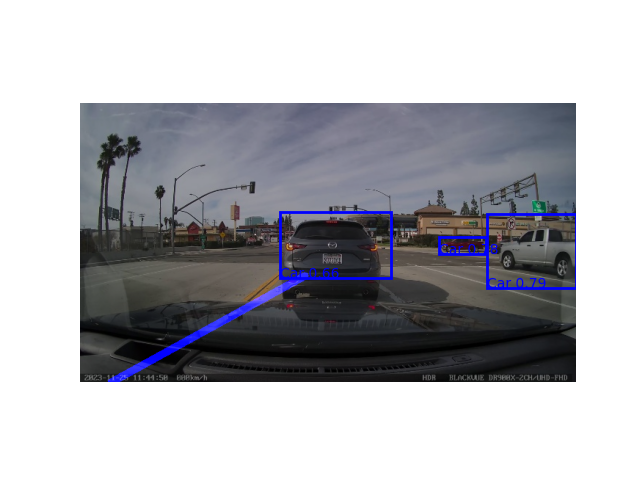

Cannot draw slope line !


[2023-12-04 19:33:38] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


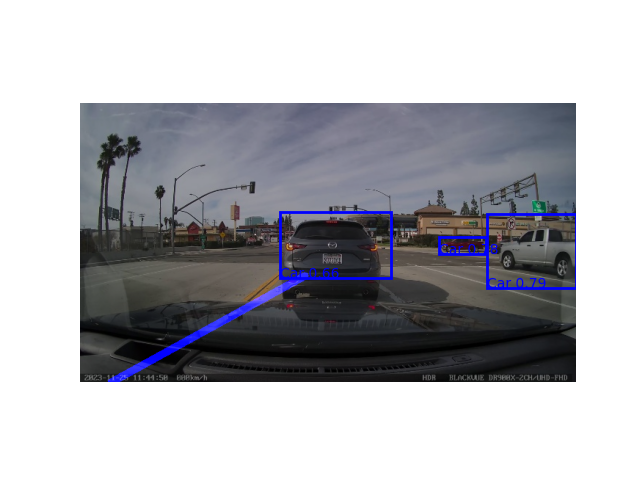

29/486
Cannot draw slope line !


[2023-12-04 19:33:39] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


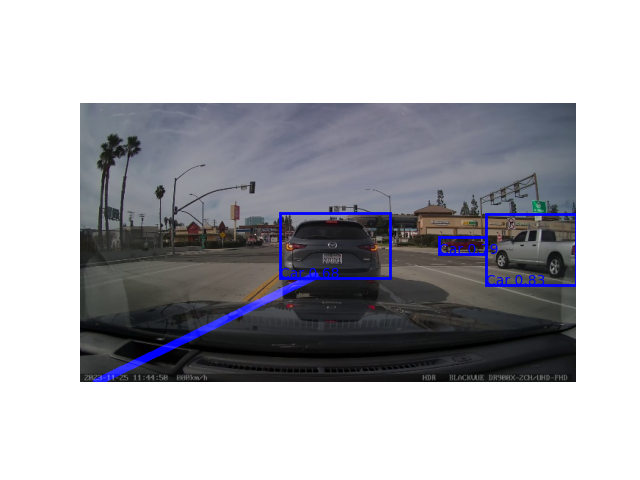

Cannot draw slope line !


[2023-12-04 19:33:39] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


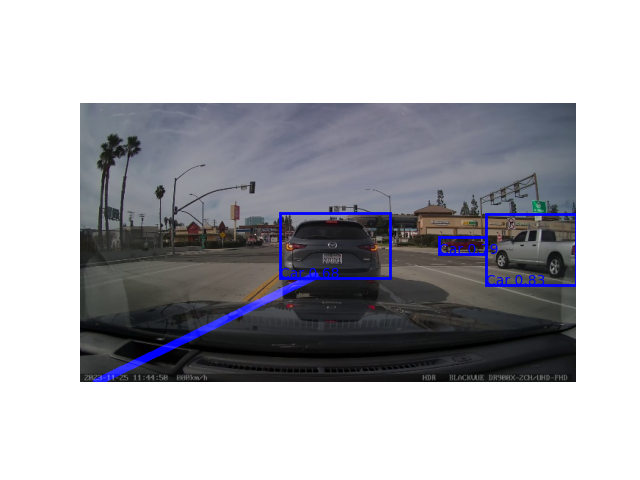

30/486
Cannot draw slope line !


[2023-12-04 19:33:39] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


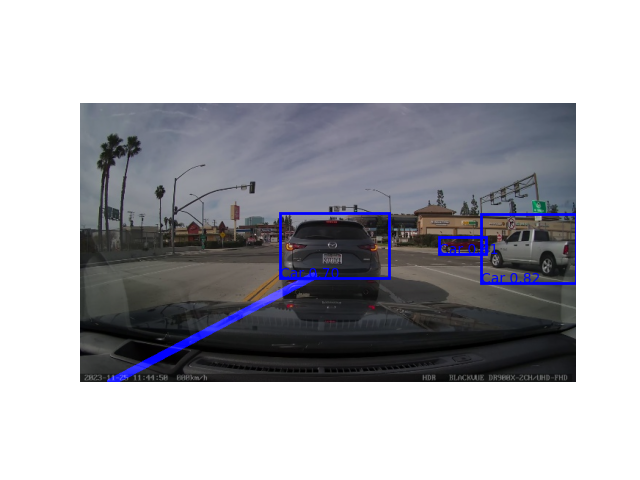

Cannot draw slope line !


[2023-12-04 19:33:40] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


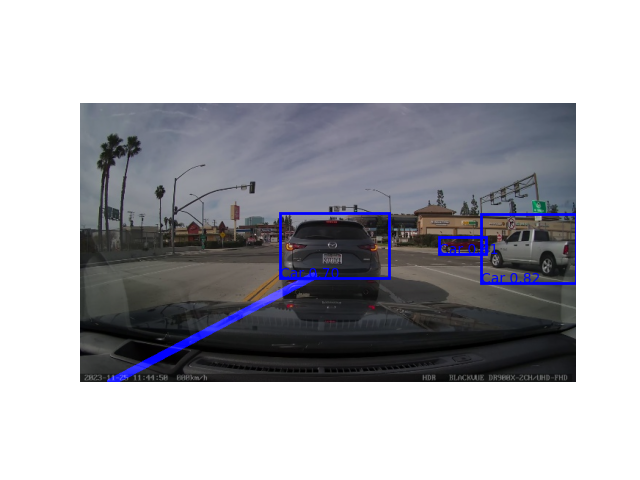

31/486
Cannot draw slope line !


[2023-12-04 19:33:40] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


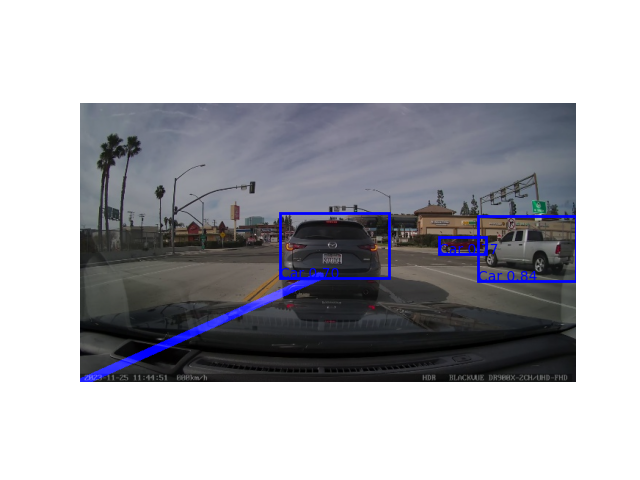

Cannot draw slope line !


[2023-12-04 19:33:40] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


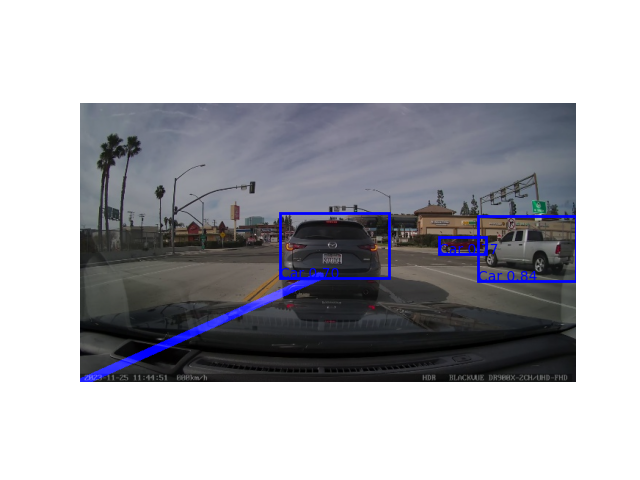

32/486
Cannot draw slope line !
Cannot draw slope line !


[2023-12-04 19:33:41] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


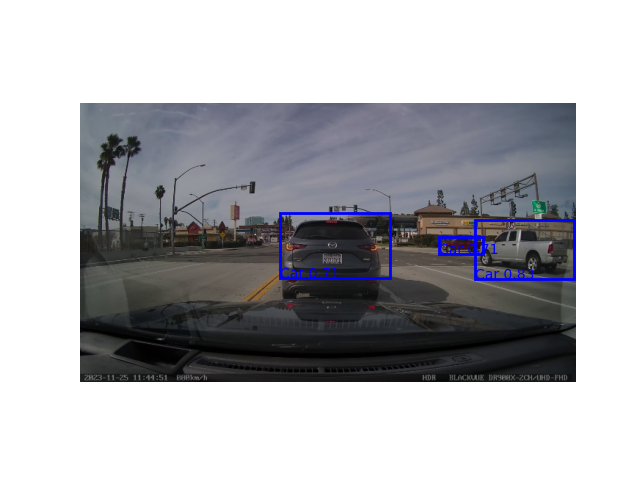

Cannot draw slope line !
Cannot draw slope line !


[2023-12-04 19:33:41] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


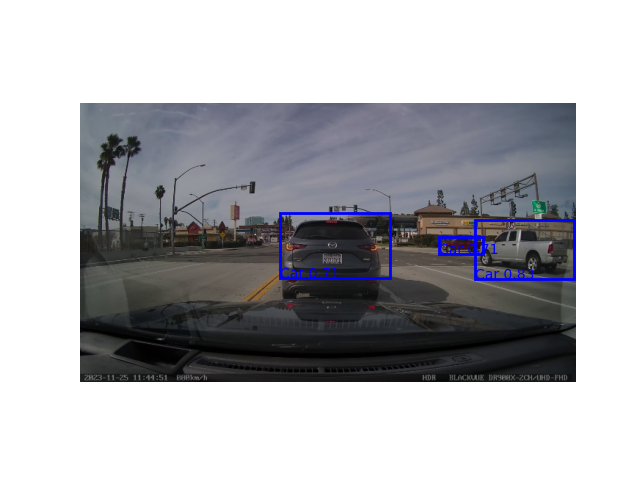

33/486
Cannot draw slope line !


[2023-12-04 19:33:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


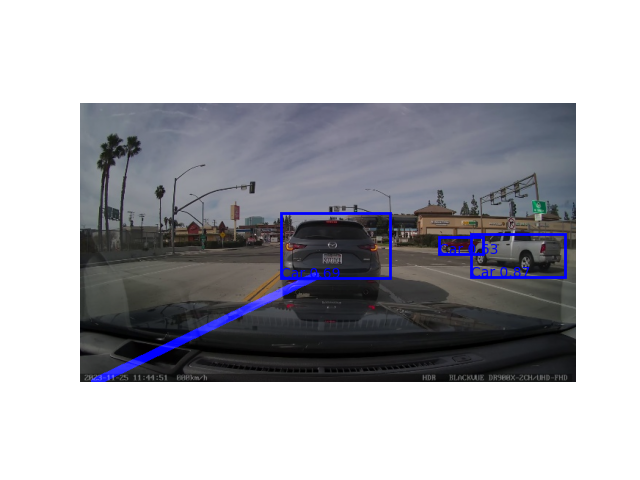

Cannot draw slope line !


[2023-12-04 19:33:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


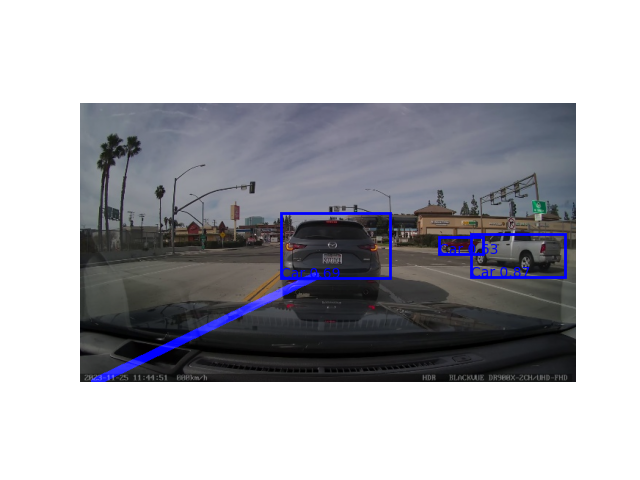

34/486
Cannot draw slope line !


[2023-12-04 19:33:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


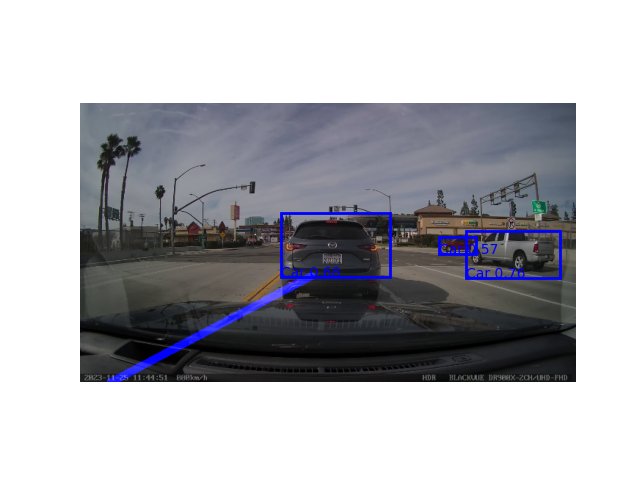

Cannot draw slope line !


[2023-12-04 19:33:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


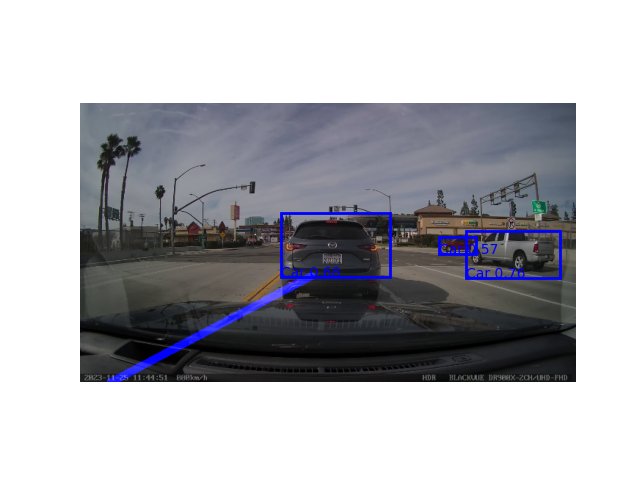

35/486
Cannot draw slope line !


[2023-12-04 19:33:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


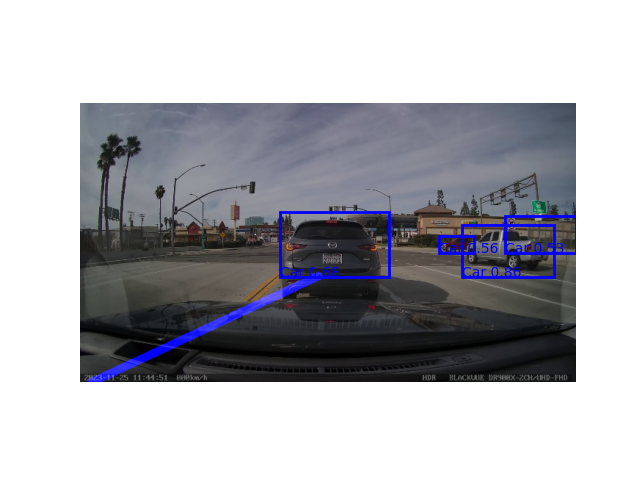

Cannot draw slope line !


[2023-12-04 19:33:44] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


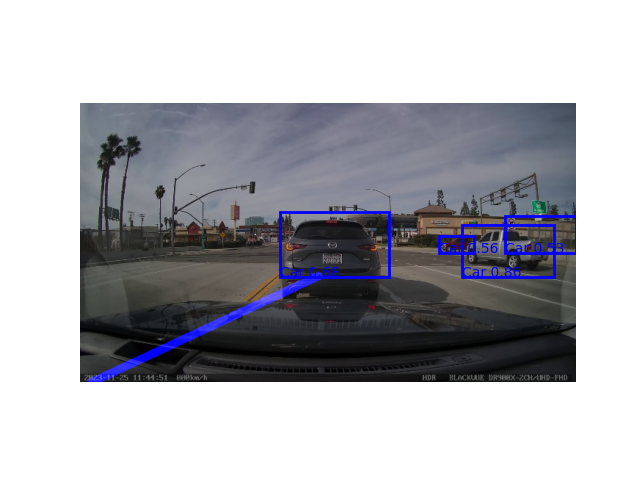

36/486
Cannot draw slope line !


[2023-12-04 19:33:44] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


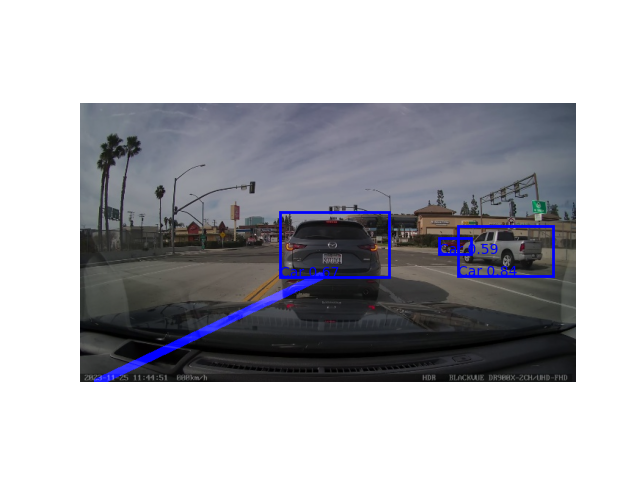

Cannot draw slope line !


[2023-12-04 19:33:44] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


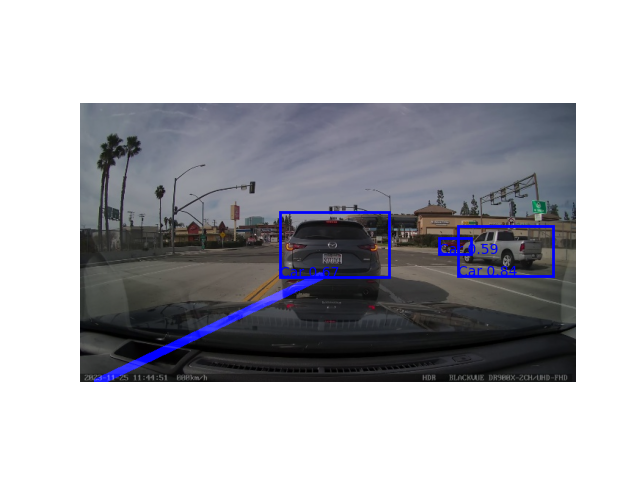

37/486
Cannot draw slope line !


[2023-12-04 19:33:45] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


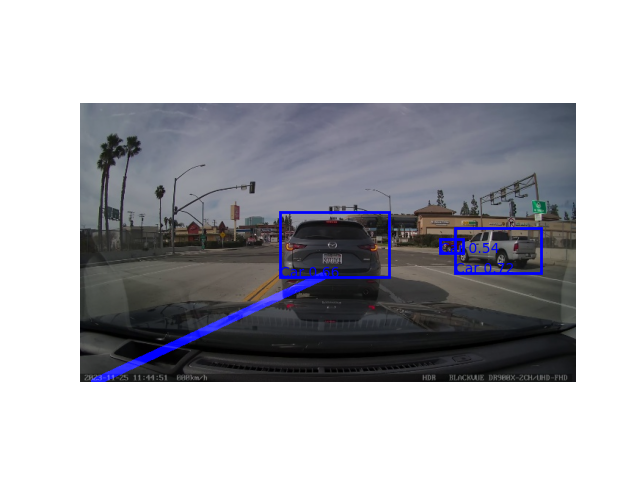

Cannot draw slope line !


[2023-12-04 19:33:45] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


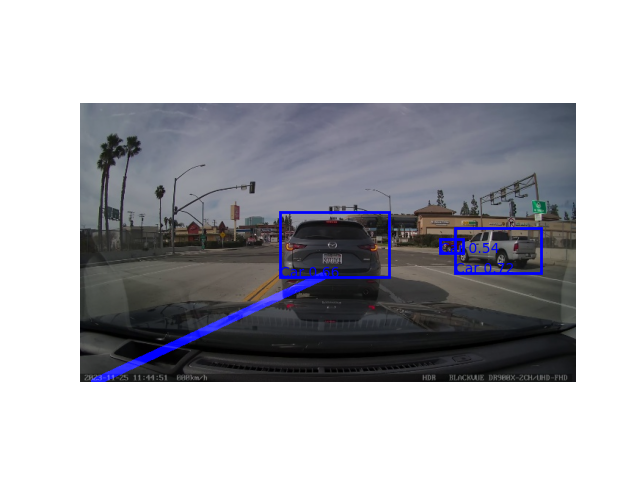

38/486
Cannot draw slope line !


[2023-12-04 19:33:45] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


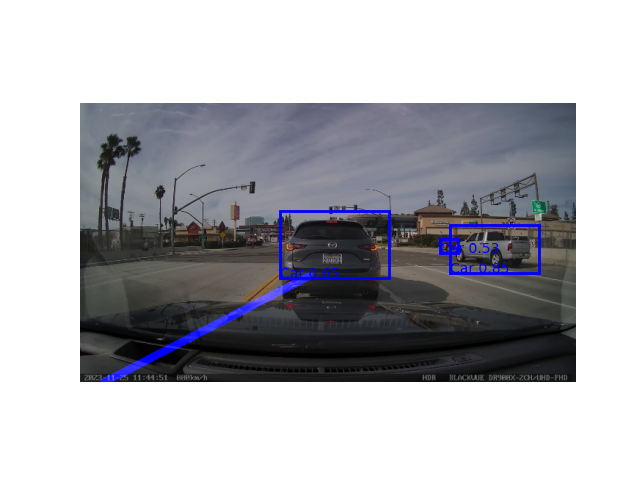

Cannot draw slope line !


[2023-12-04 19:33:46] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


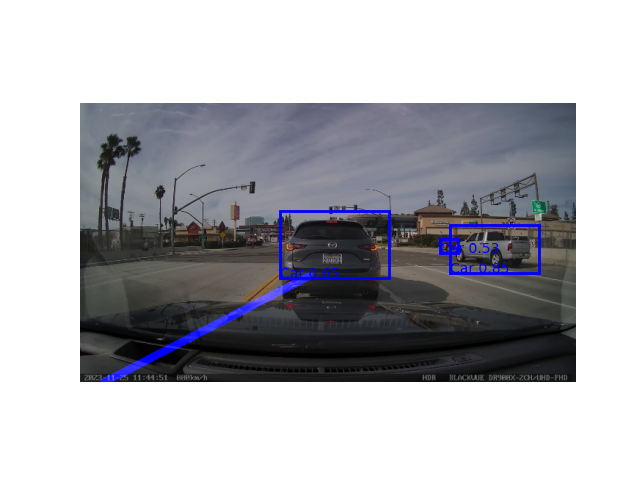

39/486
Cannot draw slope line !


[2023-12-04 19:33:46] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


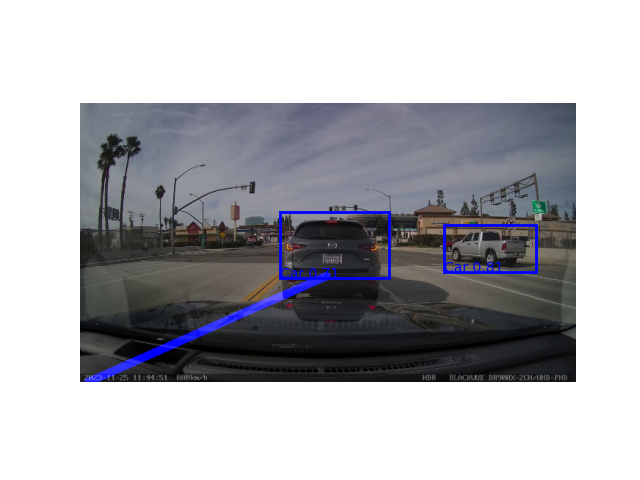

Cannot draw slope line !


[2023-12-04 19:33:46] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


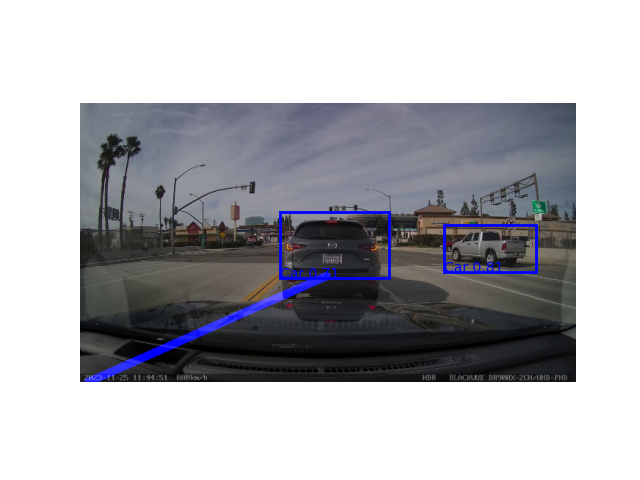

40/486
Cannot draw slope line !


[2023-12-04 19:33:47] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


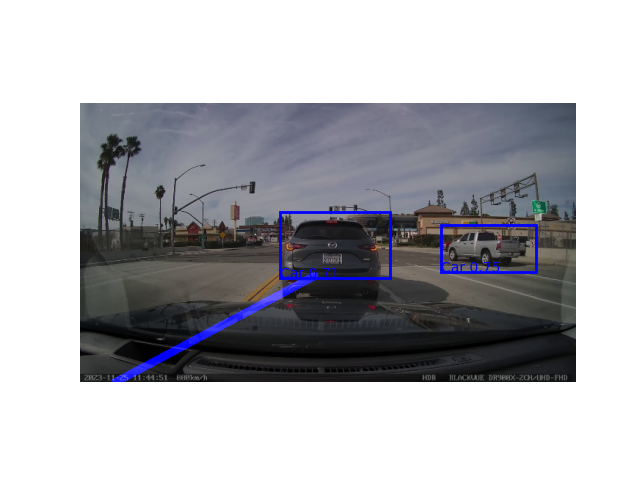

Cannot draw slope line !


[2023-12-04 19:33:47] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


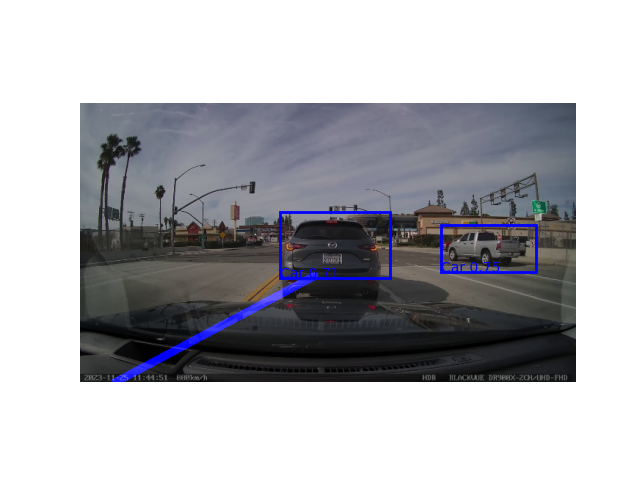

41/486
Cannot draw slope line !


[2023-12-04 19:33:47] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


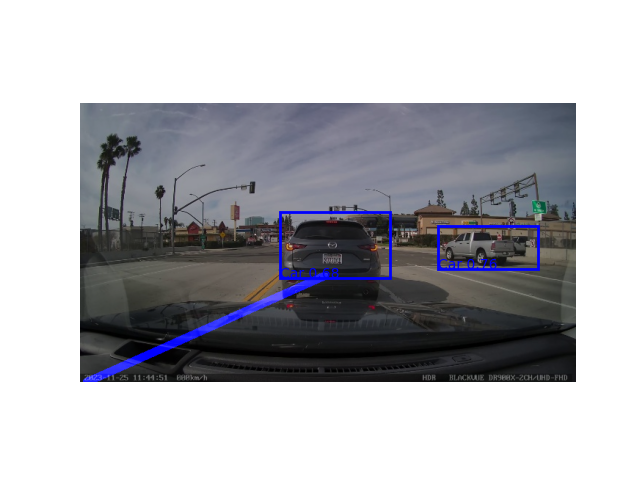

Cannot draw slope line !


[2023-12-04 19:33:48] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


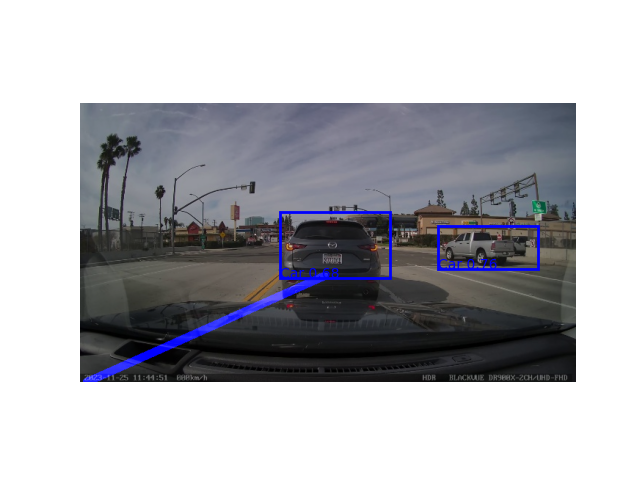

42/486
Cannot draw slope line !


[2023-12-04 19:33:48] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


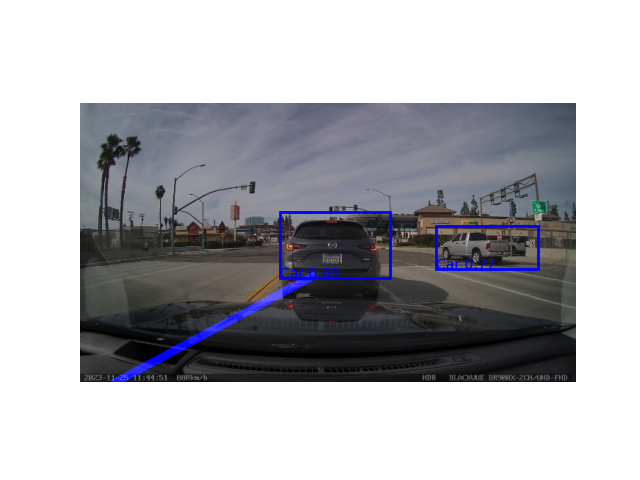

Cannot draw slope line !


[2023-12-04 19:33:48] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


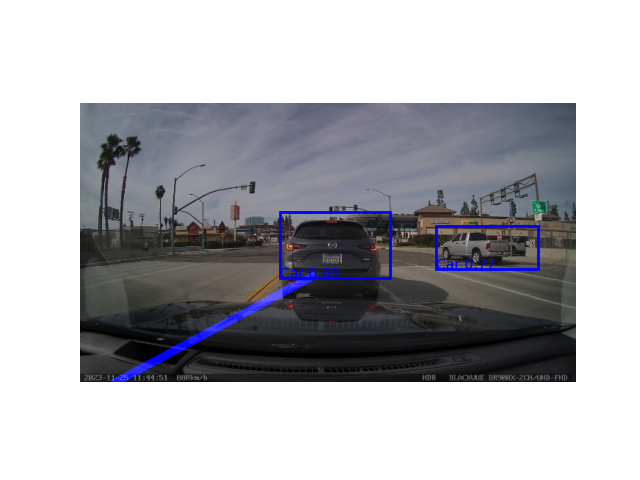

43/486
Cannot draw slope line !


[2023-12-04 19:33:49] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


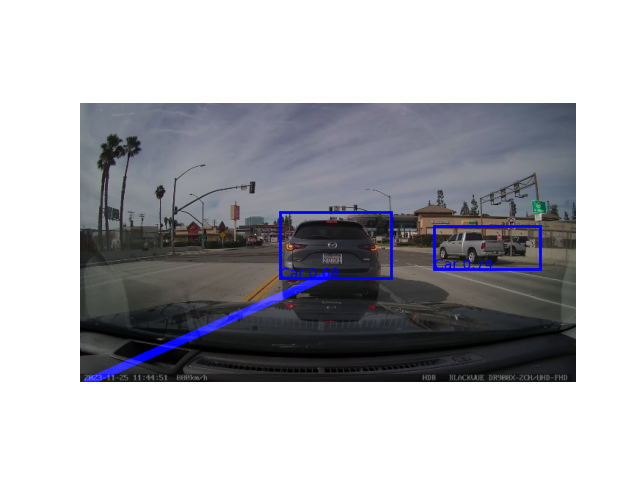

Cannot draw slope line !


[2023-12-04 19:33:49] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


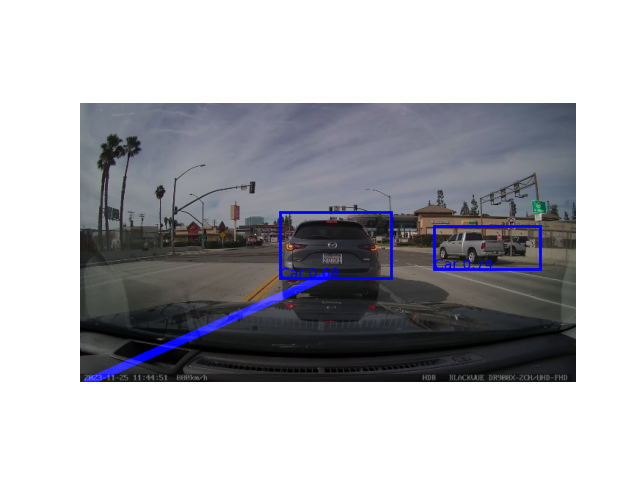

44/486
Cannot draw slope line !


[2023-12-04 19:33:49] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


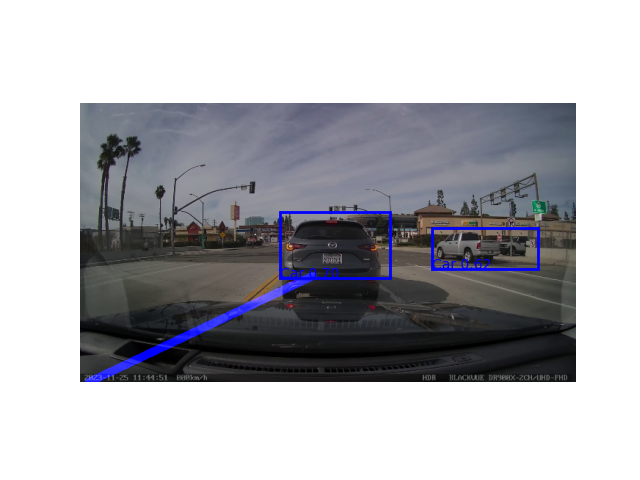

Cannot draw slope line !


[2023-12-04 19:33:50] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


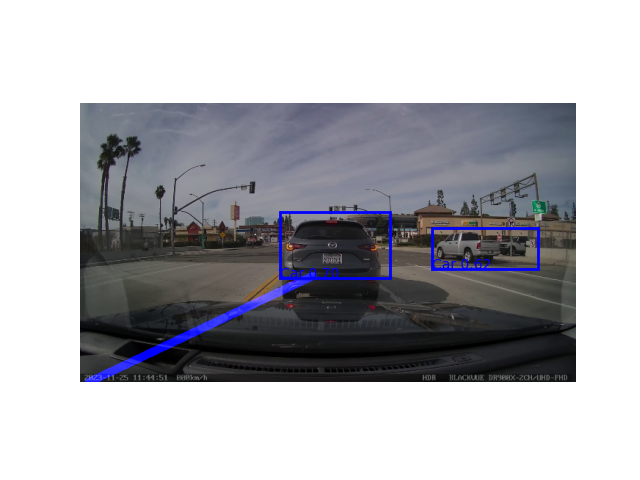

45/486
Cannot draw slope line !


[2023-12-04 19:33:50] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


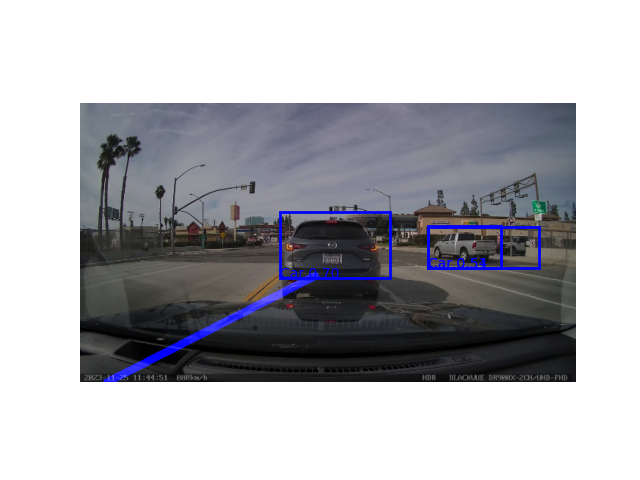

Cannot draw slope line !


[2023-12-04 19:33:51] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


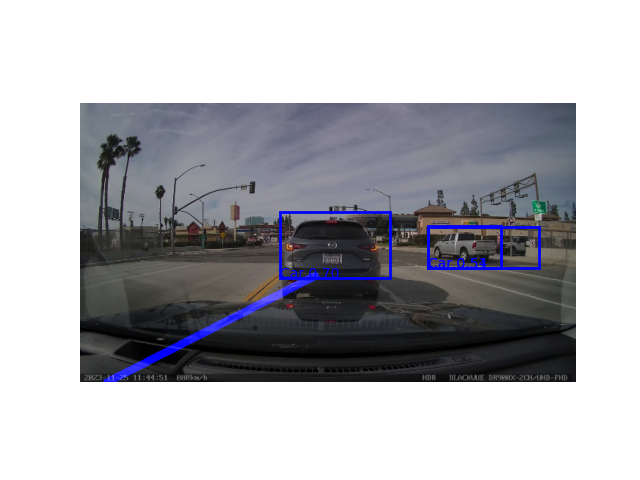

46/486
Cannot draw slope line !


[2023-12-04 19:33:51] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


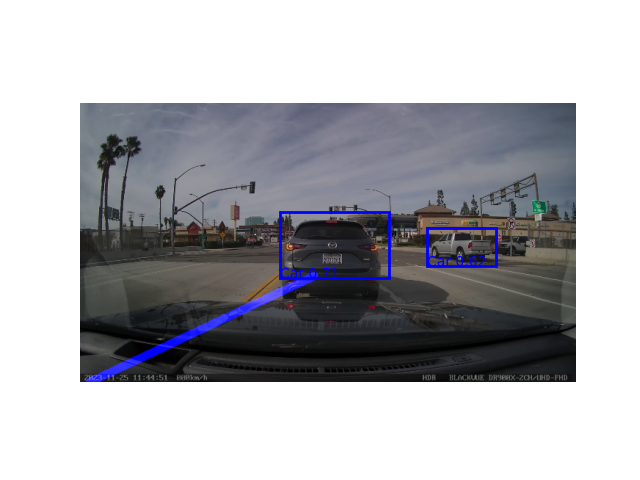

Cannot draw slope line !


[2023-12-04 19:33:52] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


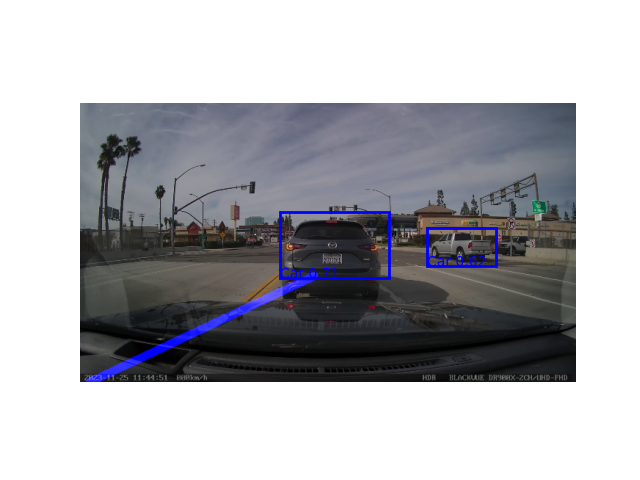

47/486
Cannot draw slope line !


[2023-12-04 19:33:52] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


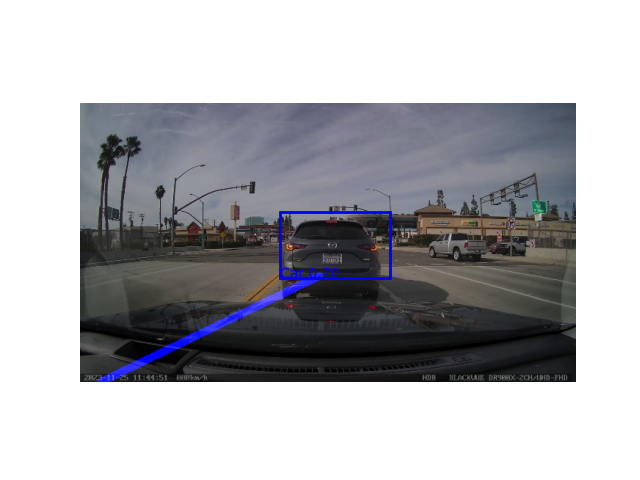

Cannot draw slope line !


[2023-12-04 19:33:52] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


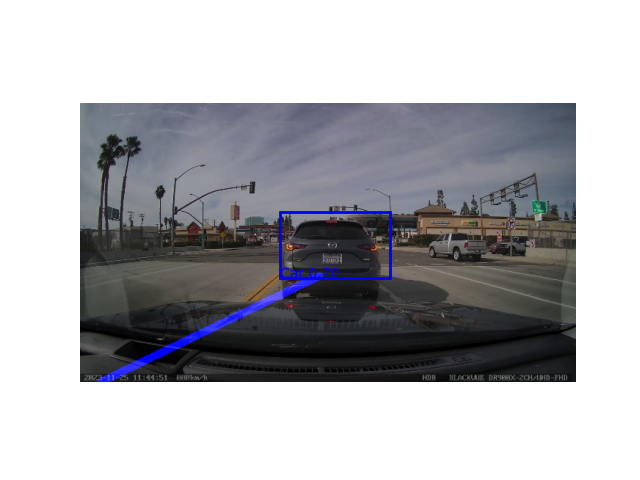

48/486
Cannot draw slope line !


[2023-12-04 19:33:53] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


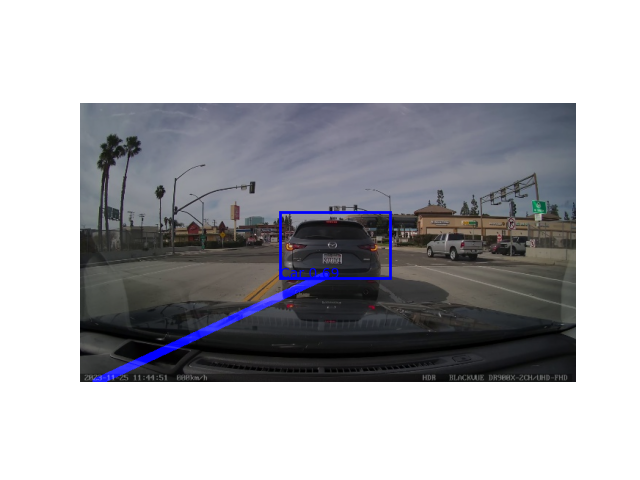

Cannot draw slope line !


[2023-12-04 19:33:53] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


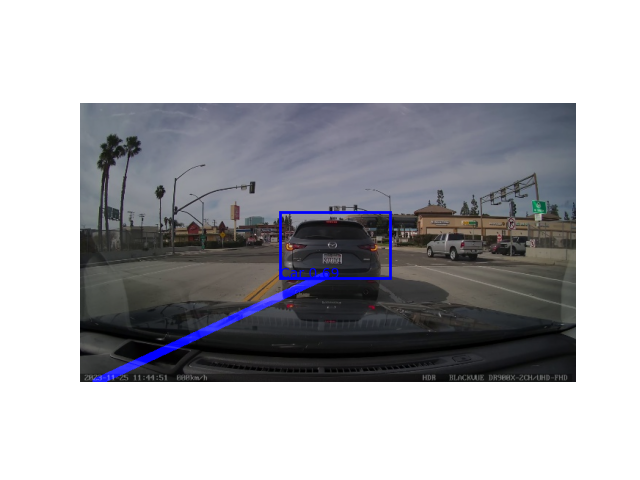

49/486
Cannot draw slope line !


[2023-12-04 19:33:54] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


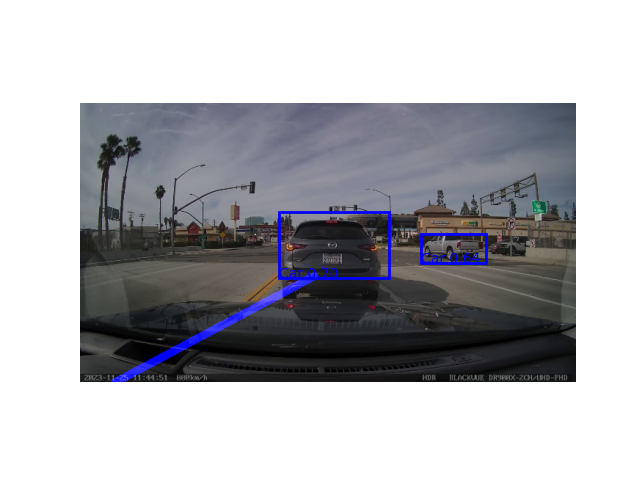

Cannot draw slope line !


[2023-12-04 19:33:54] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


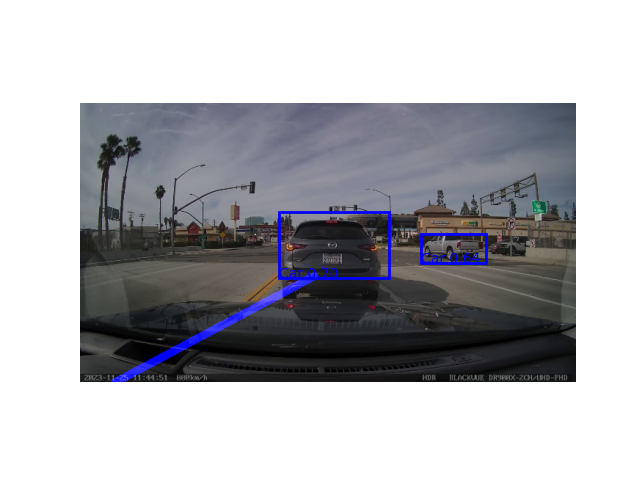

50/486
Cannot draw slope line !


[2023-12-04 19:33:54] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


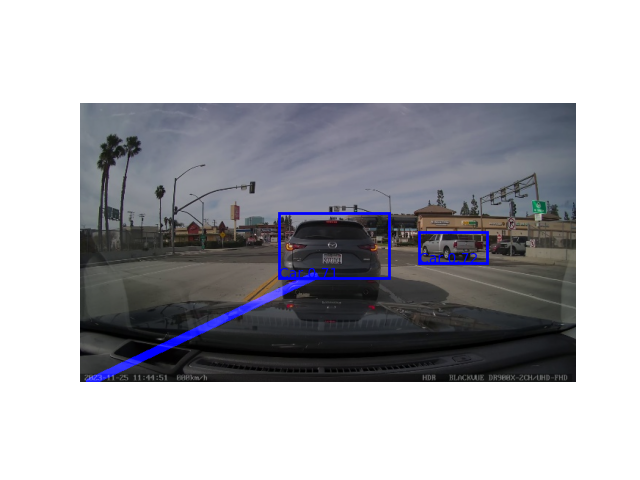

Cannot draw slope line !


[2023-12-04 19:33:55] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


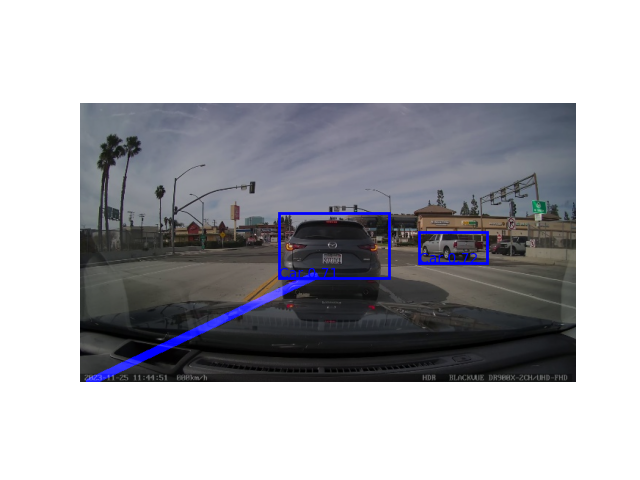

51/486
Cannot draw slope line !


[2023-12-04 19:33:55] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


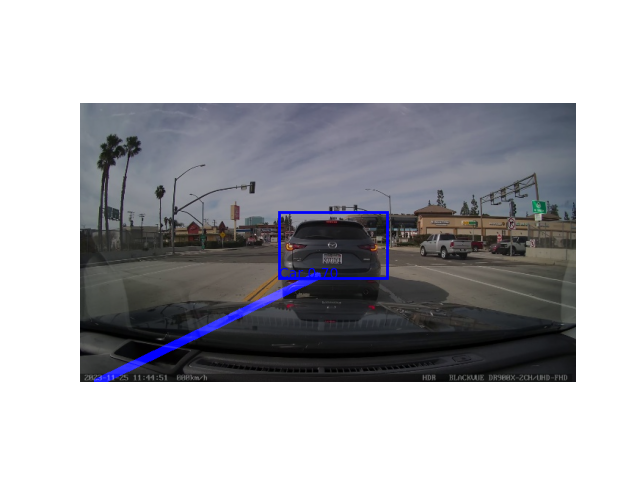

Cannot draw slope line !


[2023-12-04 19:33:55] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


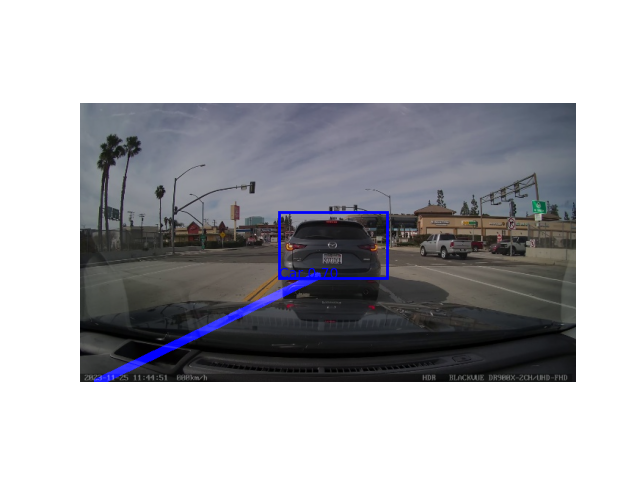

52/486
Cannot draw slope line !


[2023-12-04 19:33:56] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


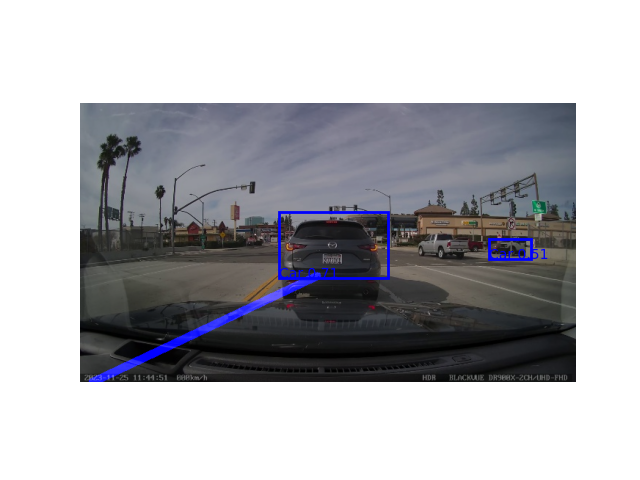

Cannot draw slope line !


[2023-12-04 19:33:56] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


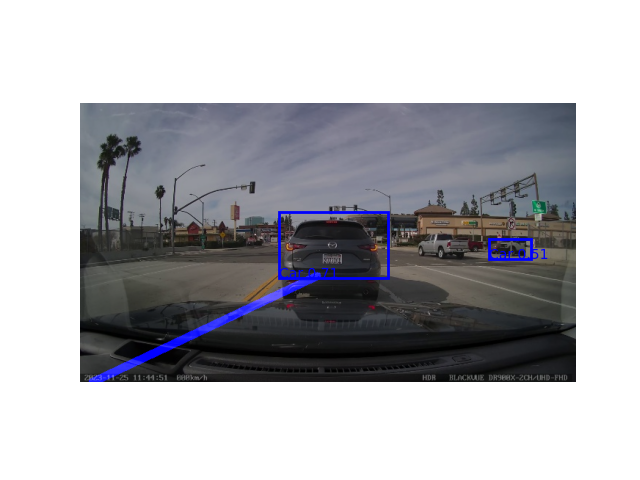

53/486
Cannot draw slope line !


[2023-12-04 19:33:56] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


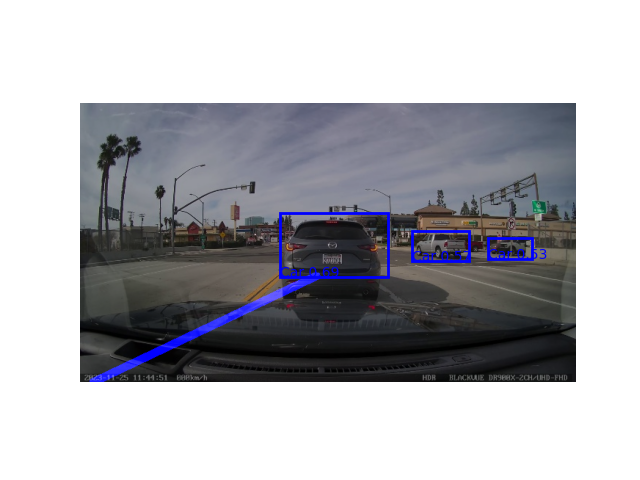

Cannot draw slope line !


[2023-12-04 19:33:57] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


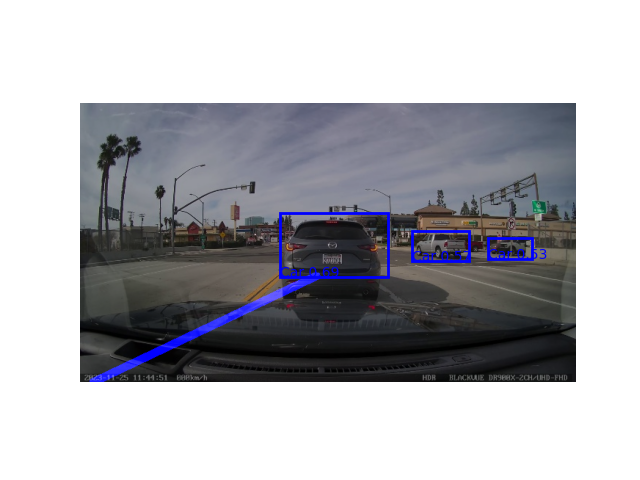

54/486
Cannot draw slope line !


[2023-12-04 19:33:57] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


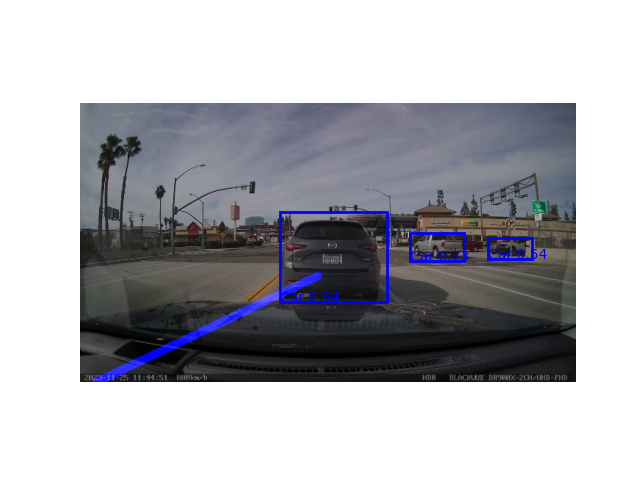

Cannot draw slope line !


[2023-12-04 19:33:57] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


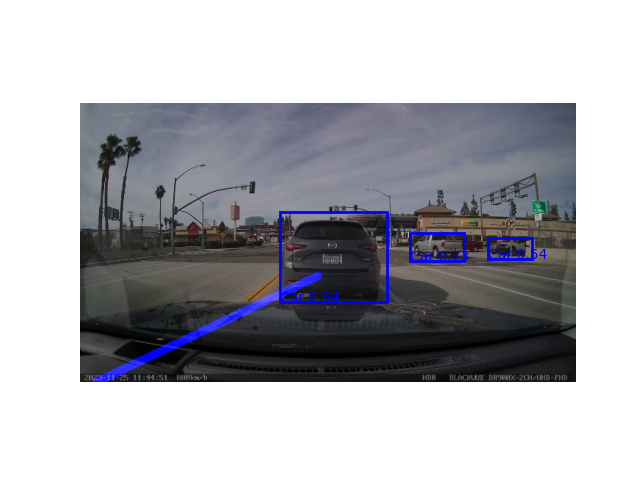

55/486
Cannot draw slope line !


[2023-12-04 19:33:58] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


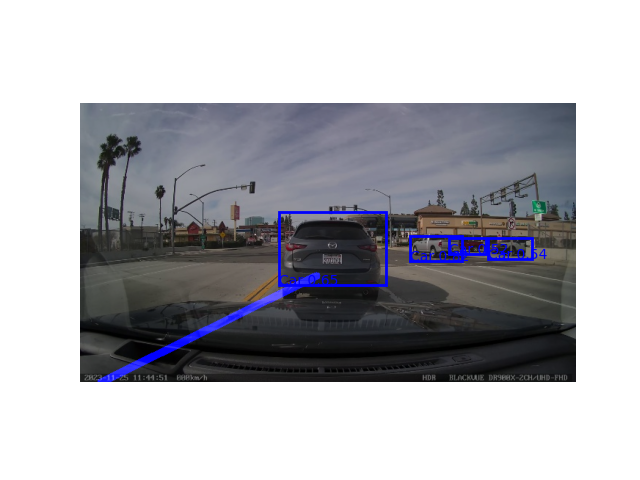

Cannot draw slope line !


[2023-12-04 19:33:58] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


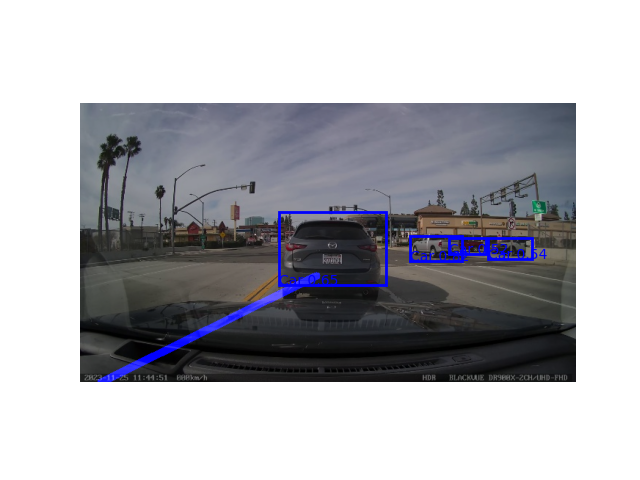

56/486
Cannot draw slope line !


[2023-12-04 19:33:58] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


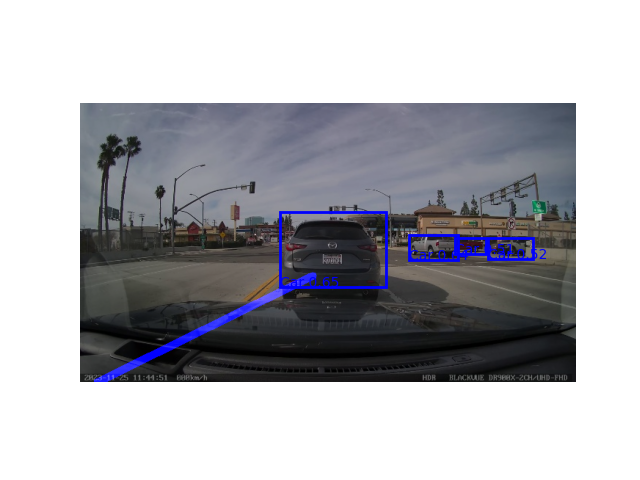

Cannot draw slope line !


[2023-12-04 19:33:59] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


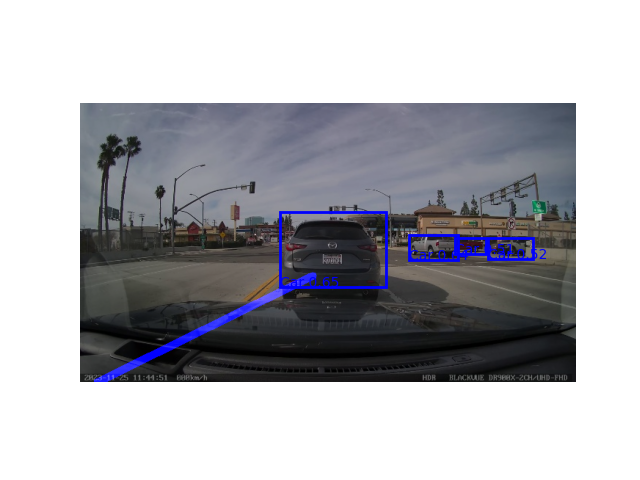

57/486
Cannot draw slope line !


[2023-12-04 19:33:59] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


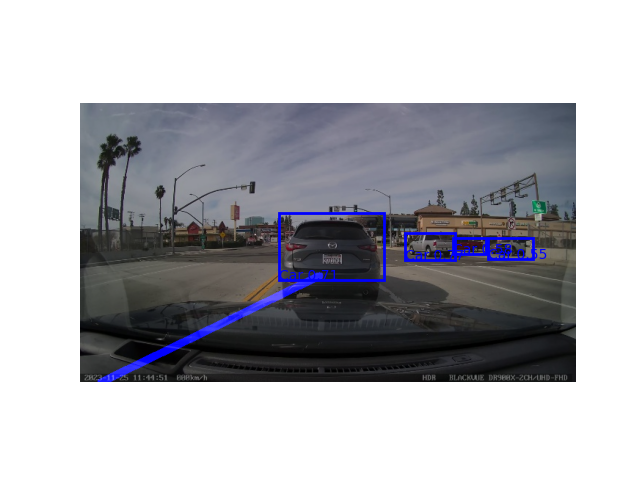

Cannot draw slope line !


[2023-12-04 19:33:59] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


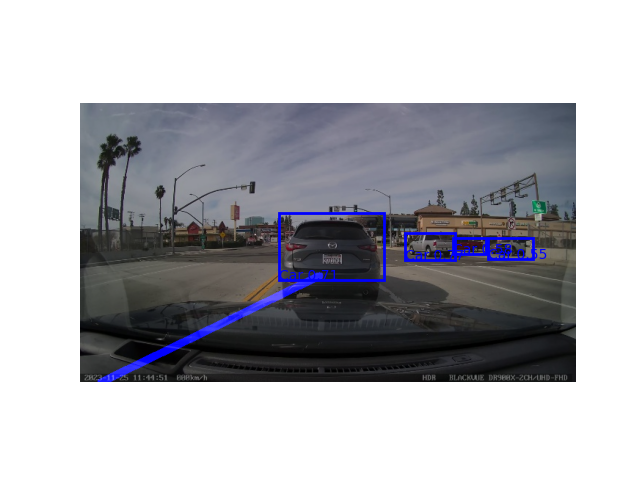

58/486
Cannot draw slope line !


[2023-12-04 19:34:00] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


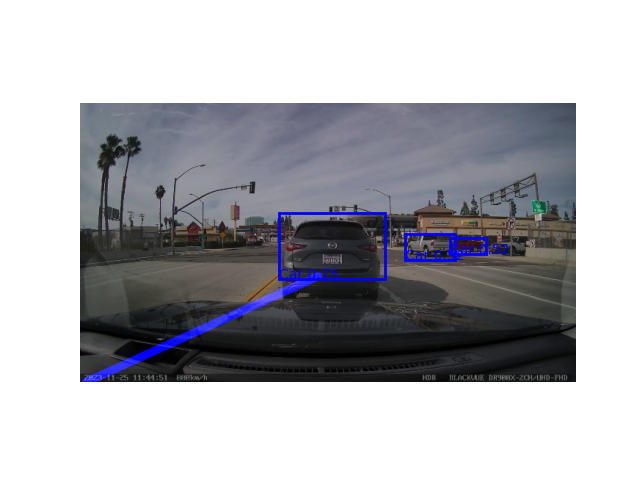

Cannot draw slope line !


[2023-12-04 19:34:00] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


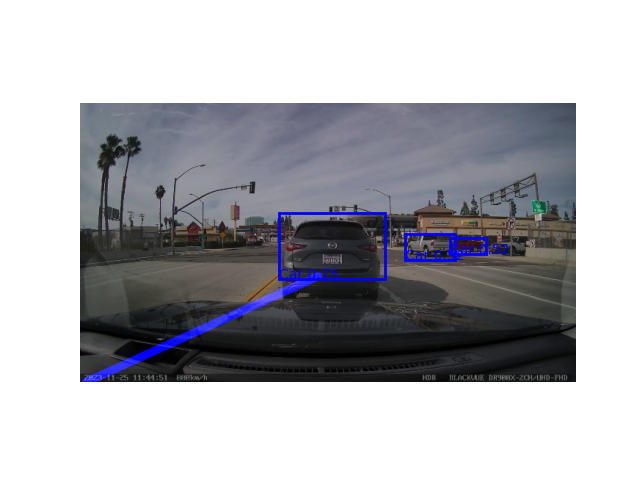

59/486
Cannot draw slope line !


[2023-12-04 19:34:01] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


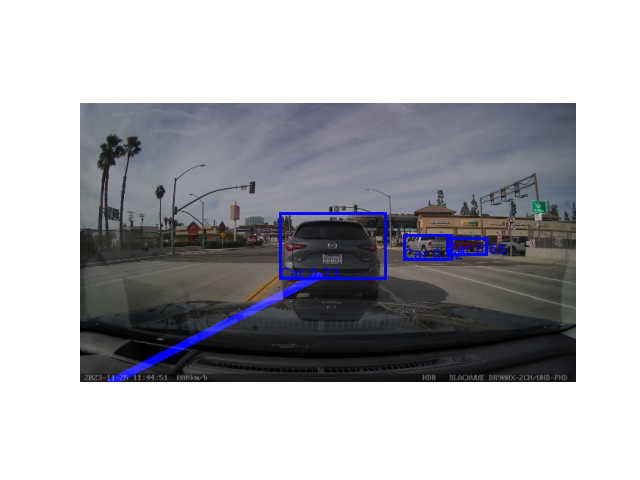

Cannot draw slope line !


[2023-12-04 19:34:01] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


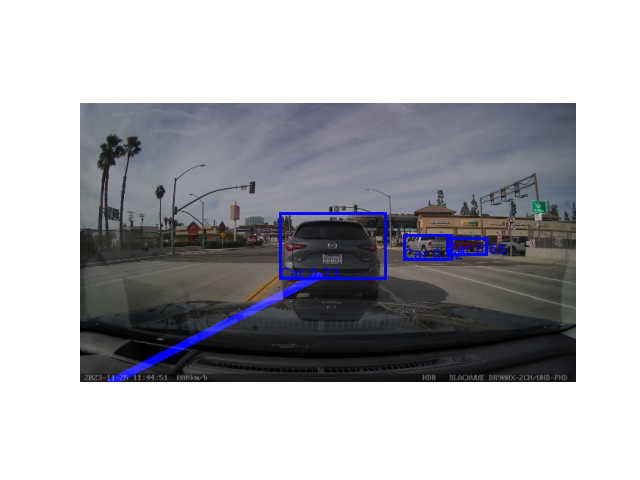

60/486
Cannot draw slope line !


[2023-12-04 19:34:02] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


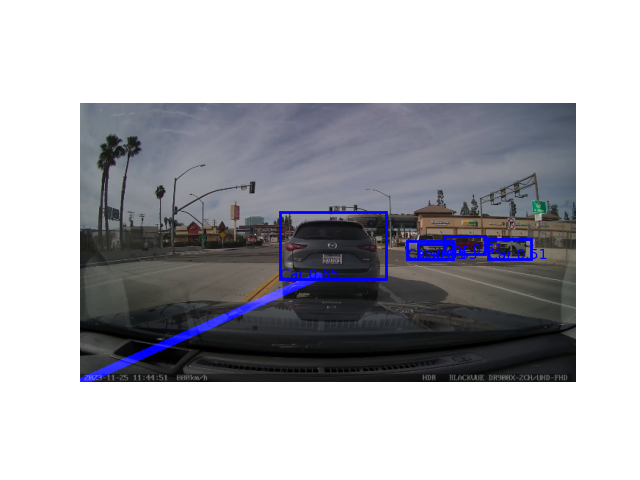

Cannot draw slope line !


[2023-12-04 19:34:02] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


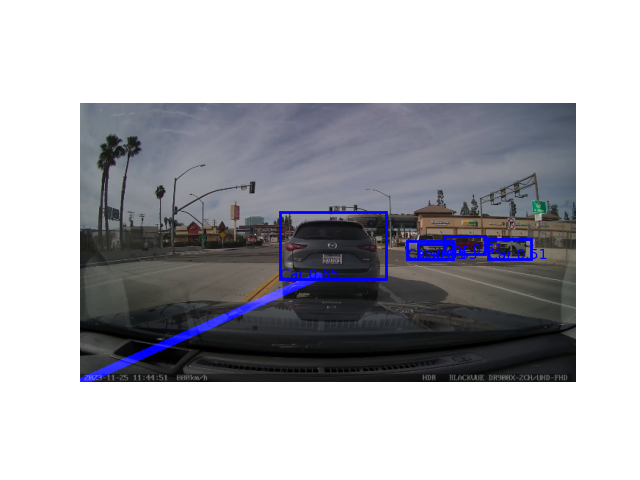

61/486
Cannot draw slope line !


[2023-12-04 19:34:03] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


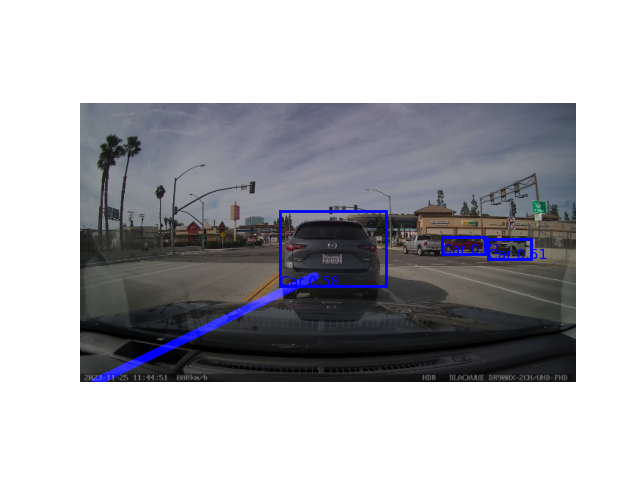

Cannot draw slope line !


[2023-12-04 19:34:03] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


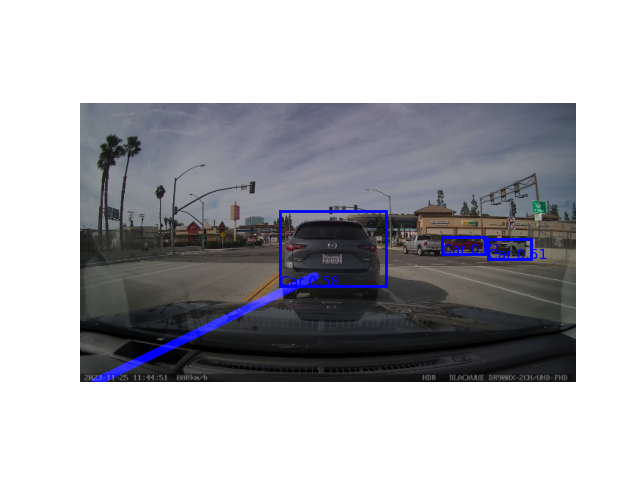

62/486
Cannot draw slope line !


[2023-12-04 19:34:03] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


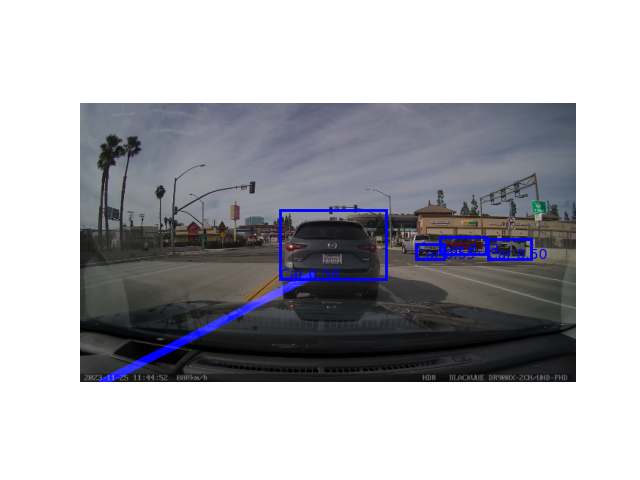

Cannot draw slope line !


[2023-12-04 19:34:04] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


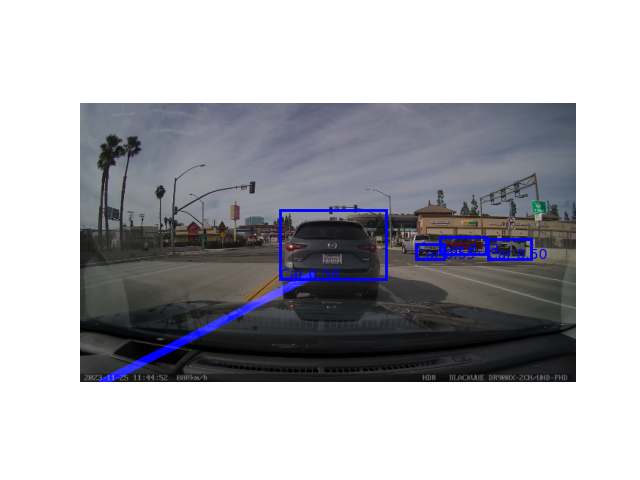

63/486


[2023-12-04 19:34:04] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


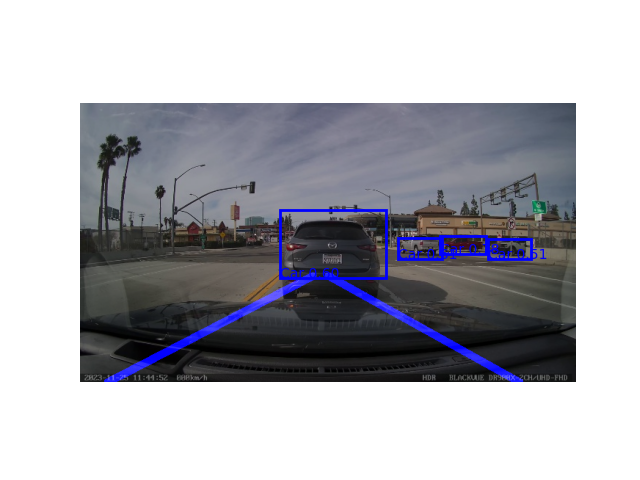

[2023-12-04 19:34:04] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


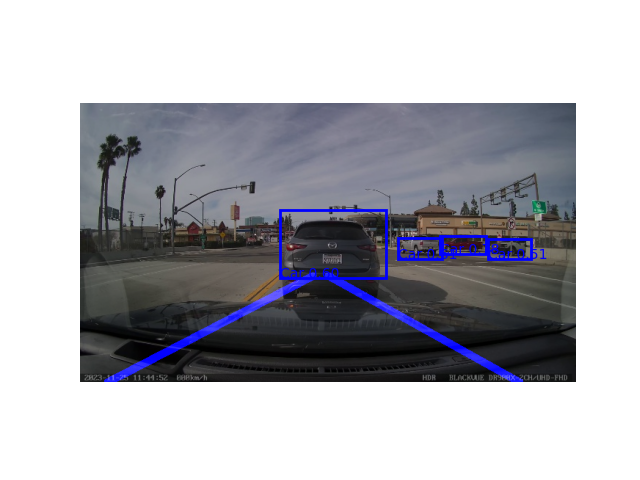

64/486
Cannot draw slope line !


[2023-12-04 19:34:05] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


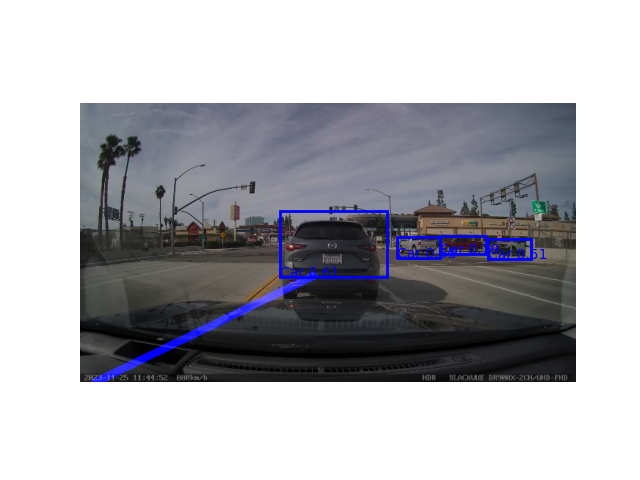

Cannot draw slope line !


[2023-12-04 19:34:05] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


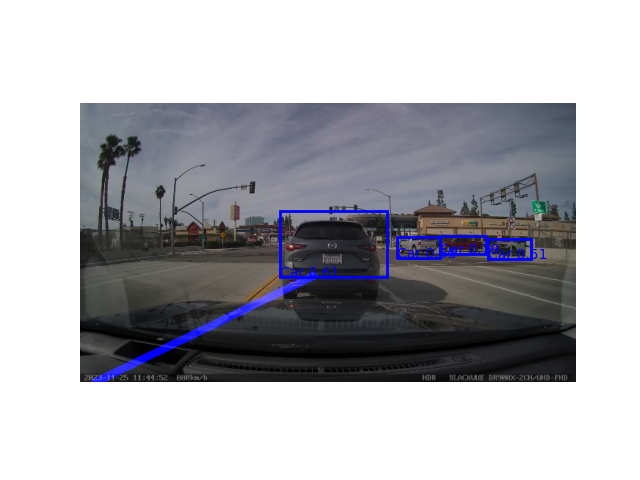

65/486
Cannot draw slope line !


[2023-12-04 19:34:05] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


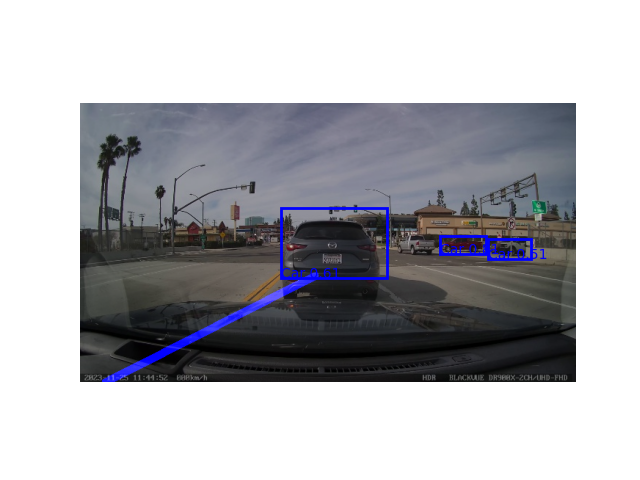

Cannot draw slope line !


[2023-12-04 19:34:06] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


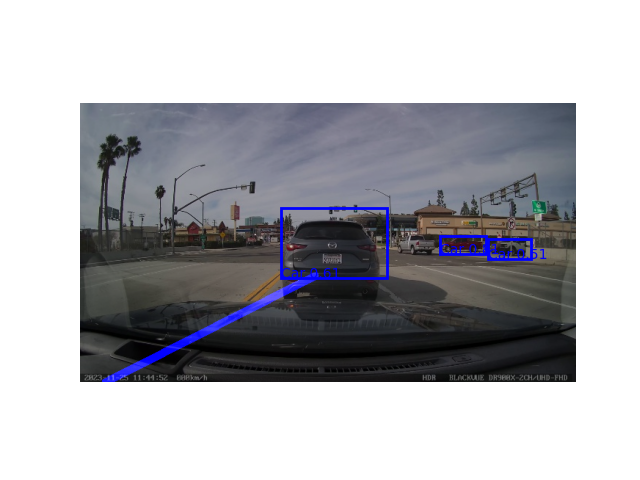

66/486


[2023-12-04 19:34:06] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


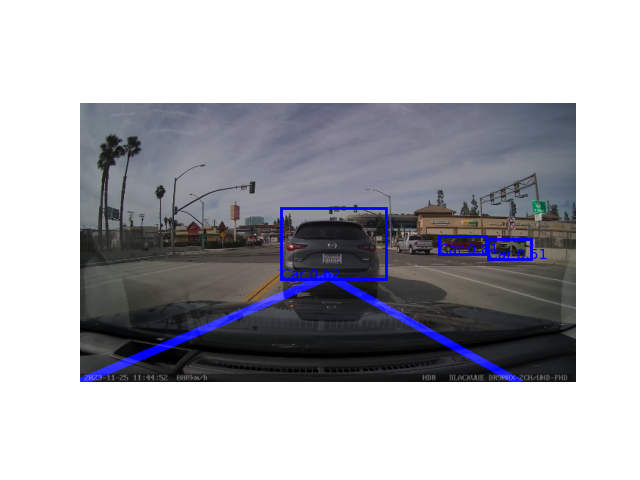

[2023-12-04 19:34:06] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


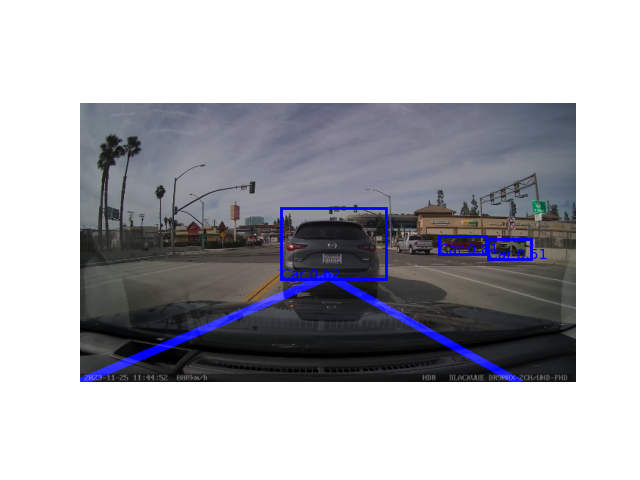

67/486


[2023-12-04 19:34:07] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


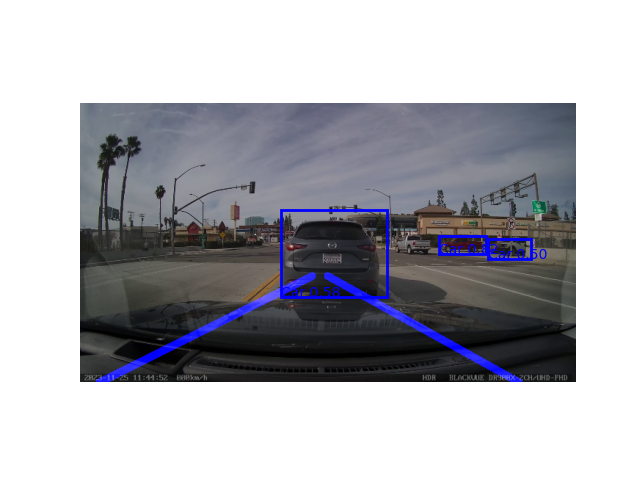

[2023-12-04 19:34:07] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


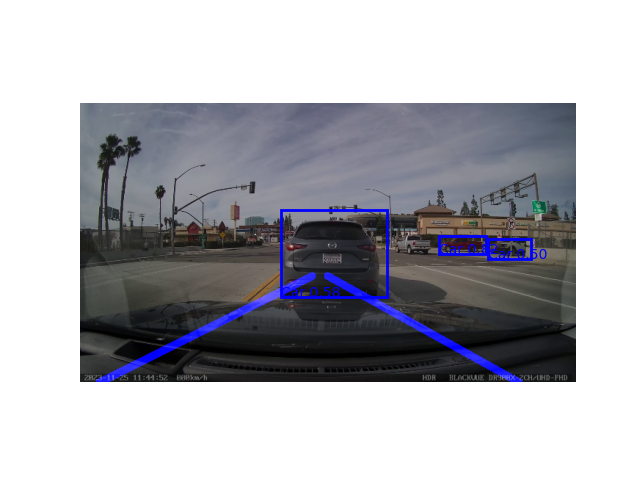

68/486


[2023-12-04 19:34:07] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


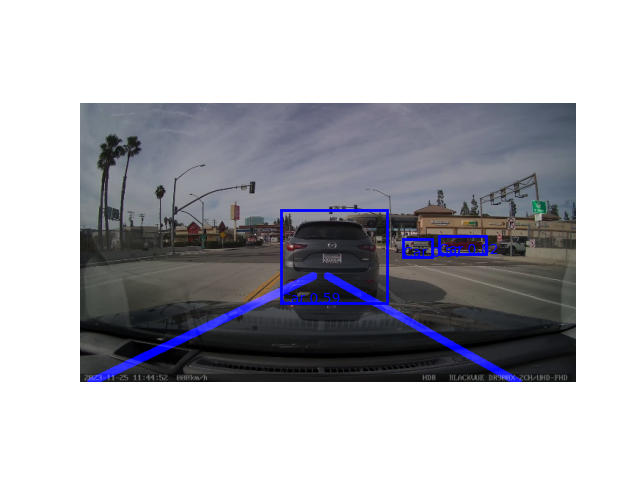

[2023-12-04 19:34:08] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


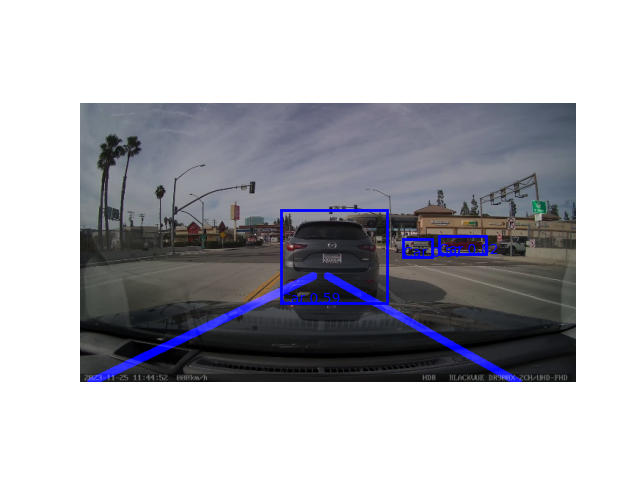

69/486


[2023-12-04 19:34:08] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


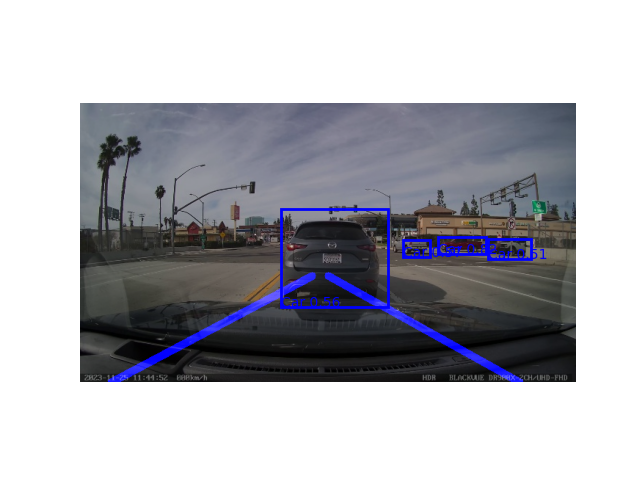

[2023-12-04 19:34:08] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


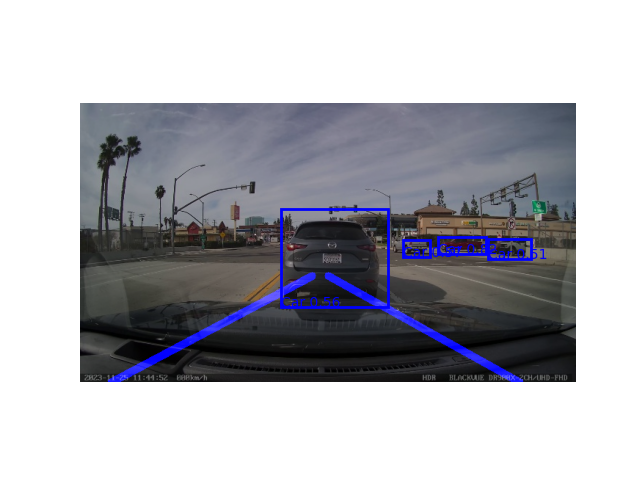

70/486


[2023-12-04 19:34:09] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


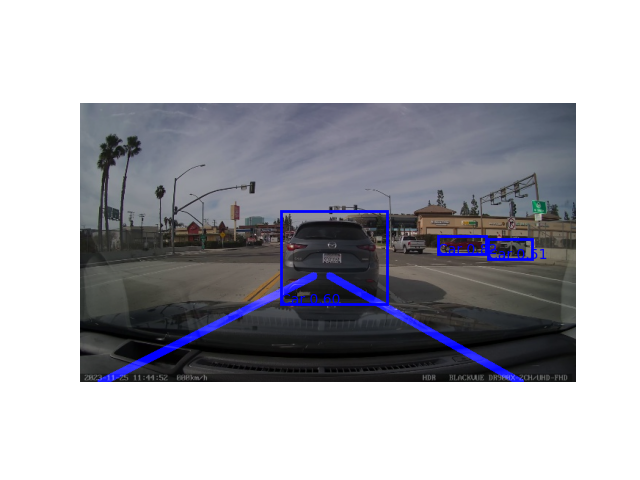

[2023-12-04 19:34:09] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


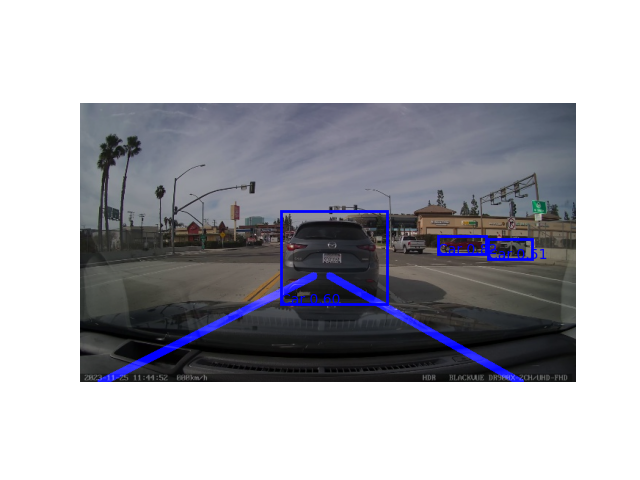

71/486
Cannot draw slope line !


[2023-12-04 19:34:09] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


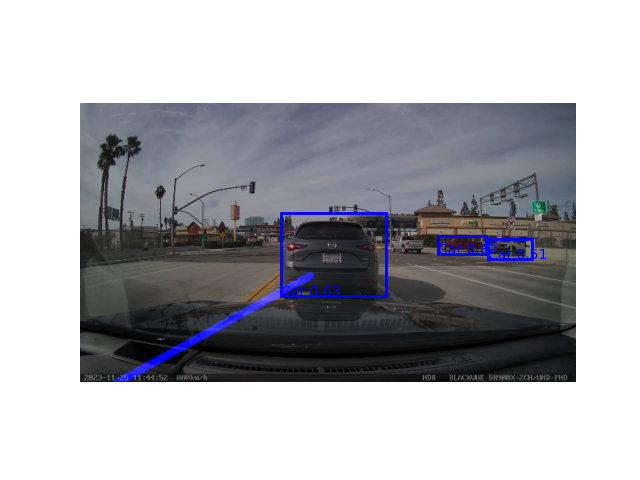

Cannot draw slope line !


[2023-12-04 19:34:10] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


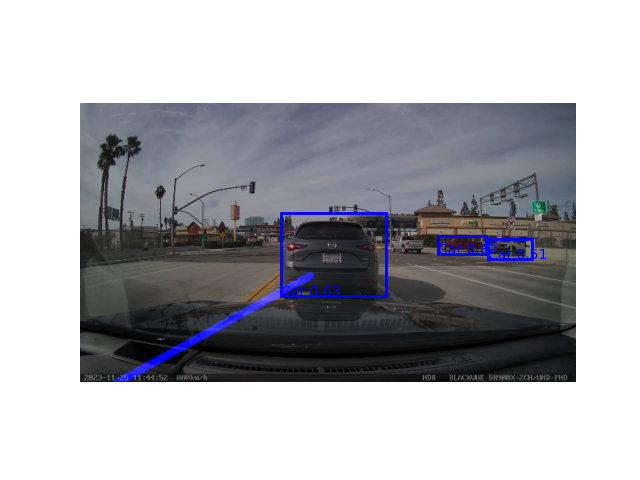

72/486
Cannot draw slope line !


[2023-12-04 19:34:10] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


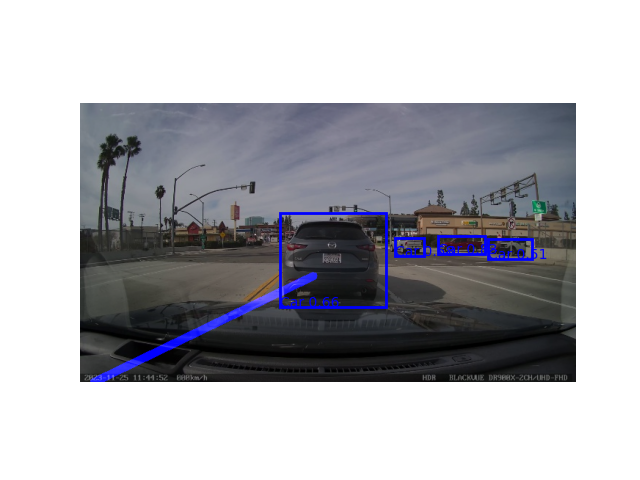

Cannot draw slope line !


[2023-12-04 19:34:11] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


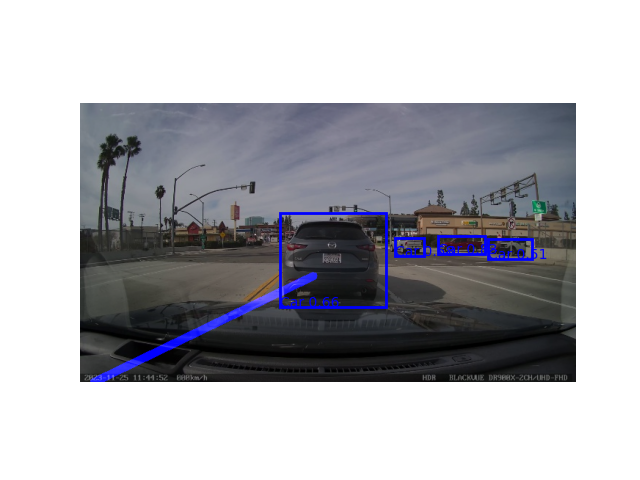

73/486
Cannot draw slope line !


[2023-12-04 19:34:12] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


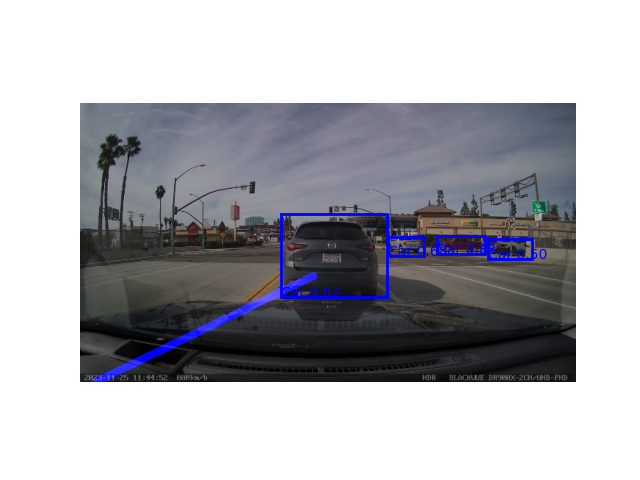

Cannot draw slope line !


[2023-12-04 19:34:12] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


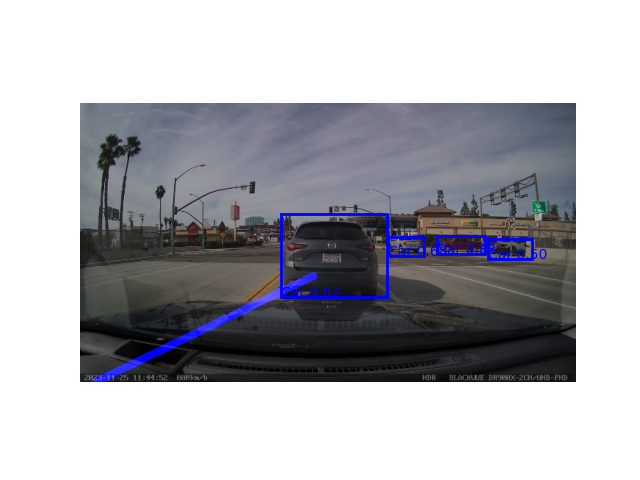

74/486
Cannot draw slope line !


[2023-12-04 19:34:12] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


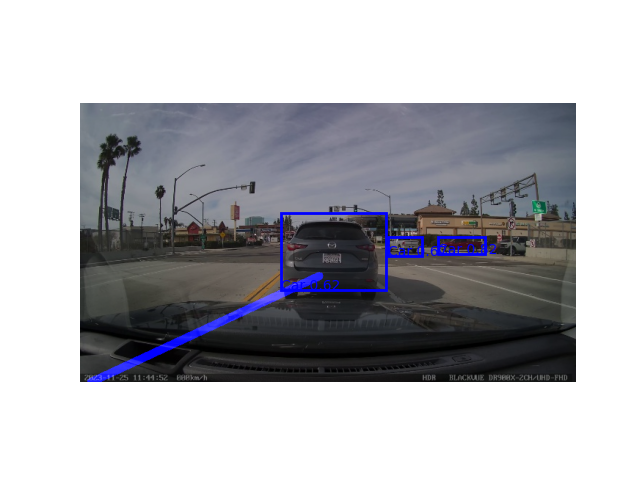

Cannot draw slope line !


[2023-12-04 19:34:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


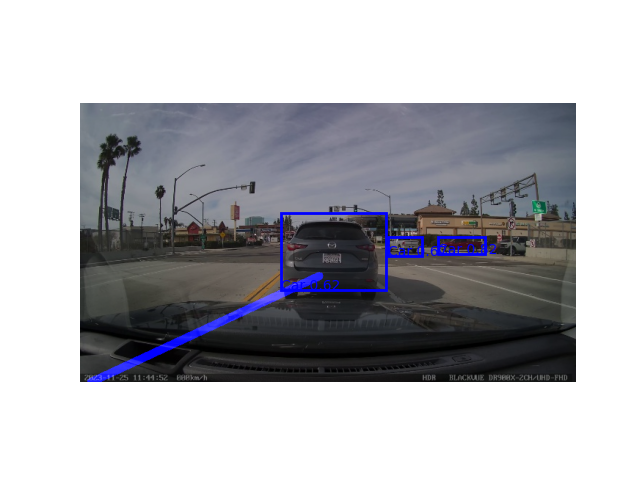

75/486
Cannot draw slope line !


[2023-12-04 19:34:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


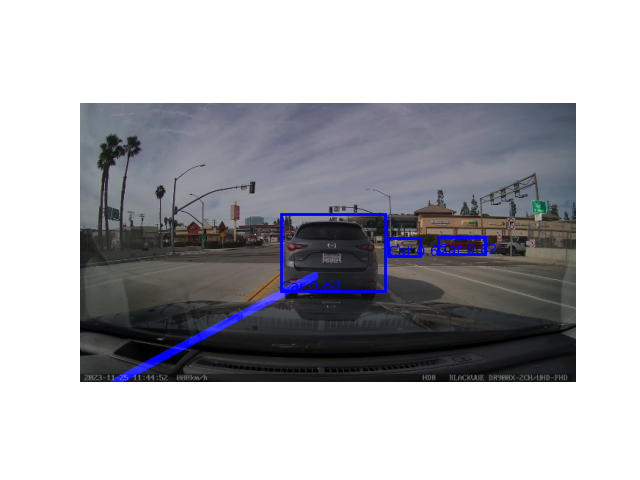

Cannot draw slope line !


[2023-12-04 19:34:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


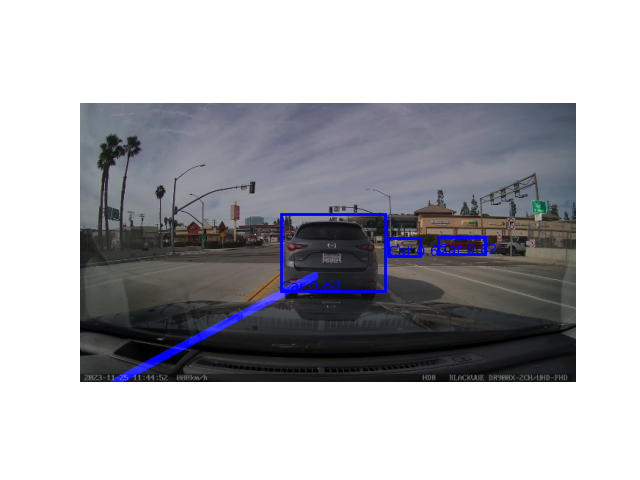

76/486
Cannot draw slope line !


[2023-12-04 19:34:14] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


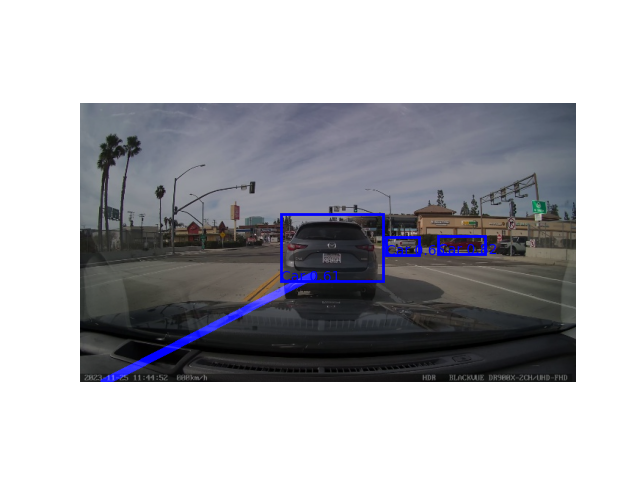

Cannot draw slope line !


[2023-12-04 19:34:14] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


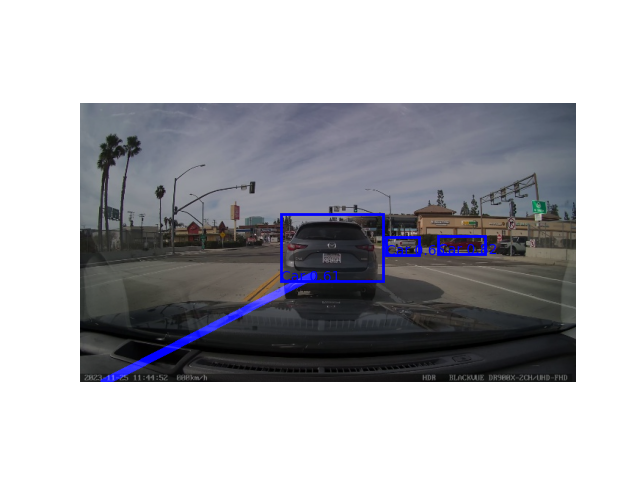

77/486
Cannot draw slope line !


[2023-12-04 19:34:14] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


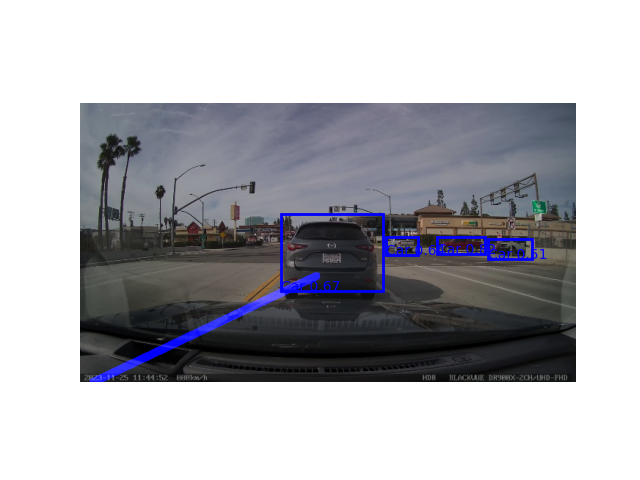

Cannot draw slope line !


[2023-12-04 19:34:15] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


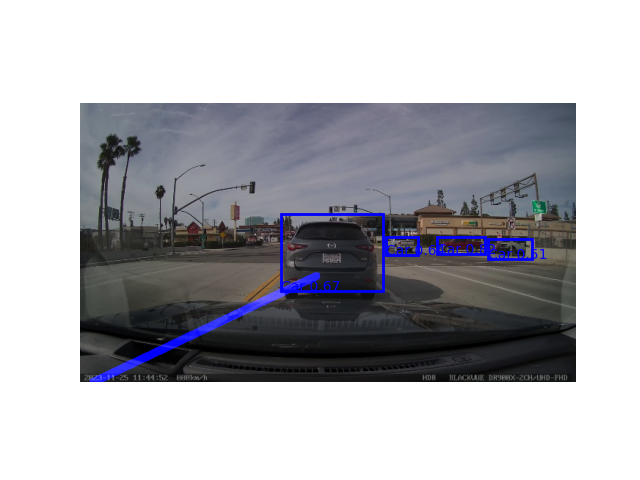

78/486
Cannot draw slope line !


[2023-12-04 19:34:15] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


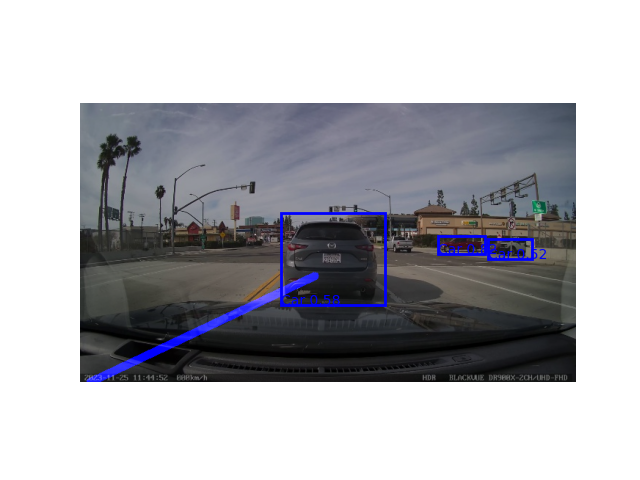

Cannot draw slope line !


[2023-12-04 19:34:15] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


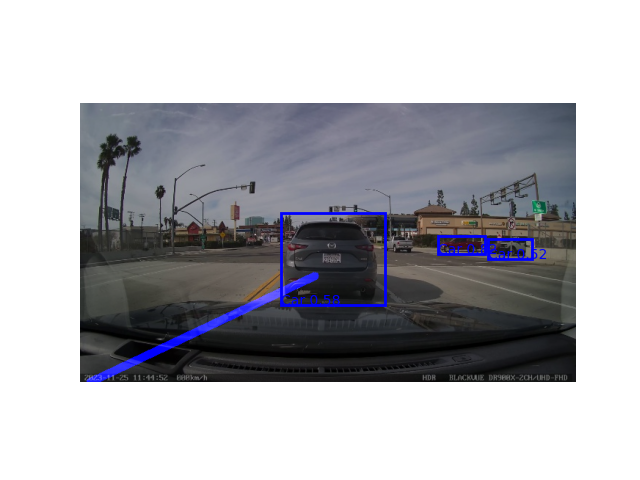

79/486
Cannot draw slope line !


[2023-12-04 19:34:16] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


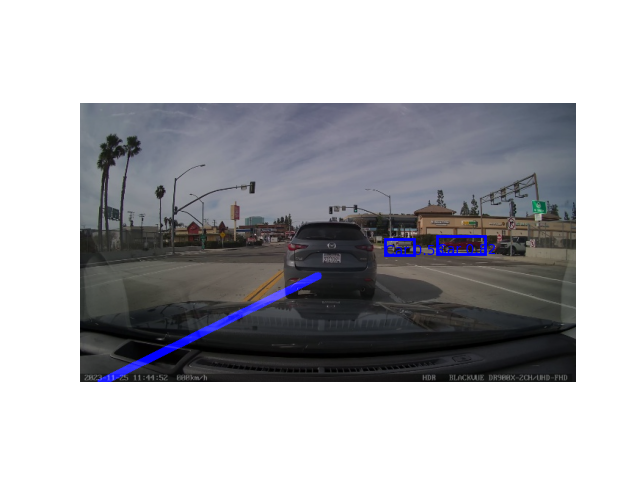

Cannot draw slope line !


[2023-12-04 19:34:16] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


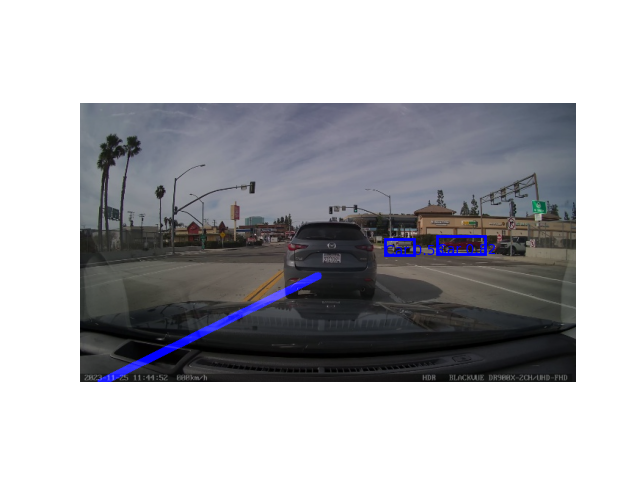

80/486
Cannot draw slope line !


[2023-12-04 19:34:16] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


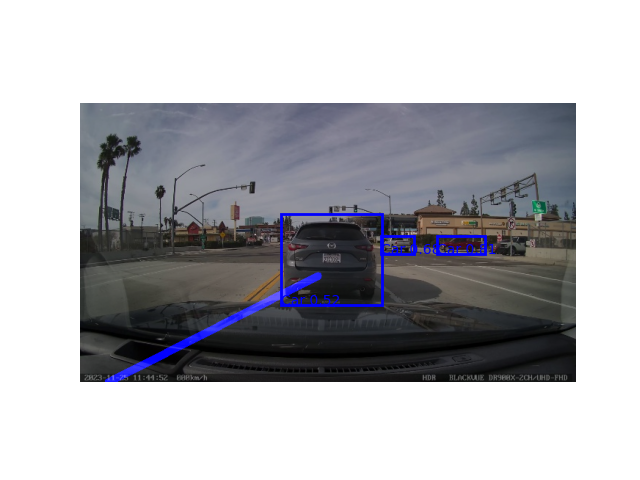

Cannot draw slope line !


[2023-12-04 19:34:17] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


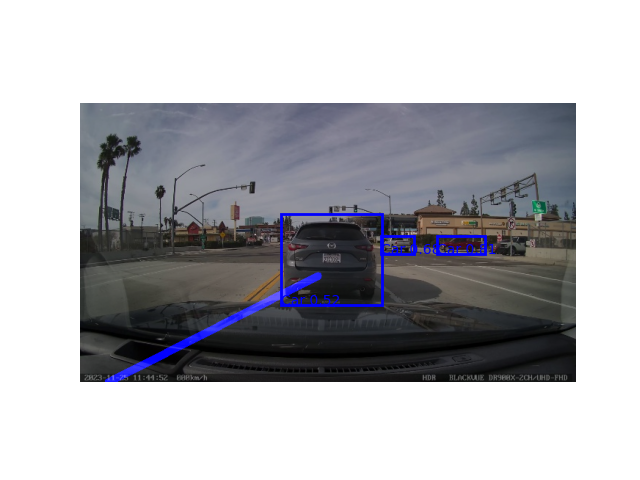

81/486
Cannot draw slope line !


[2023-12-04 19:34:17] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


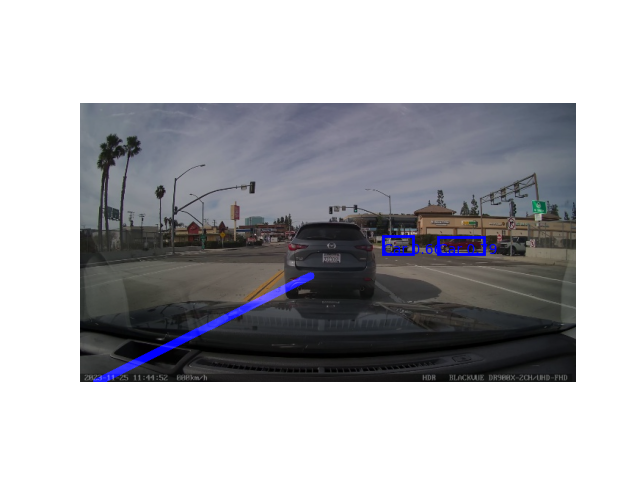

Cannot draw slope line !


[2023-12-04 19:34:17] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


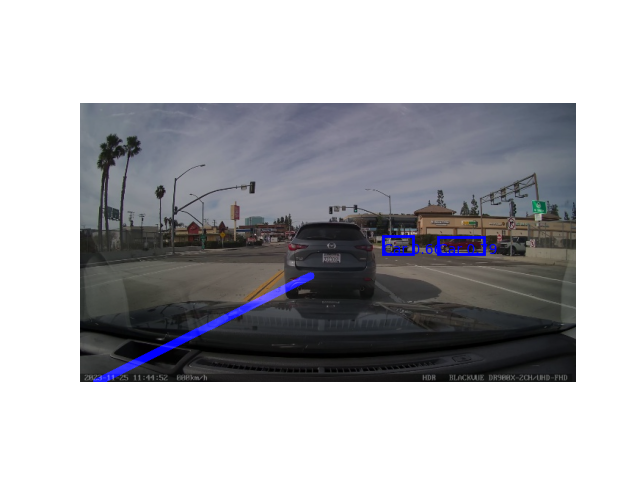

82/486
Cannot draw slope line !


[2023-12-04 19:34:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


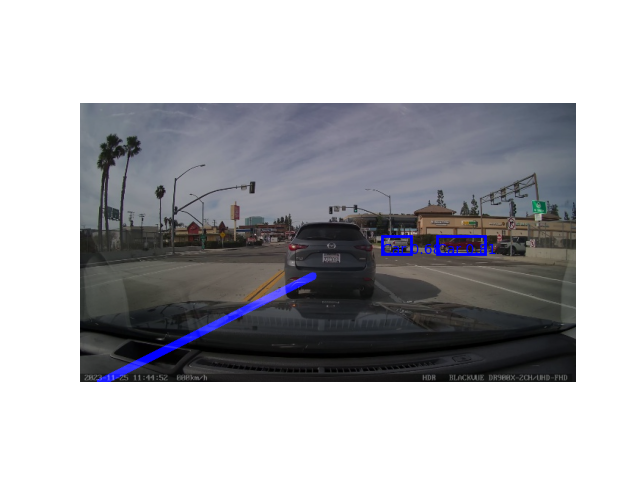

Cannot draw slope line !


[2023-12-04 19:34:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


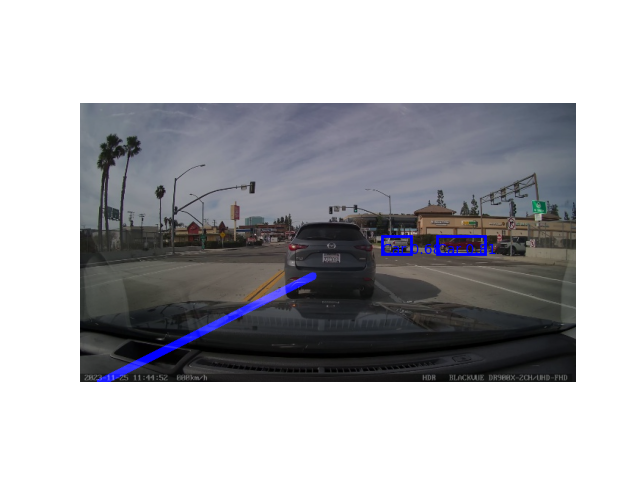

83/486
Cannot draw slope line !


[2023-12-04 19:34:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


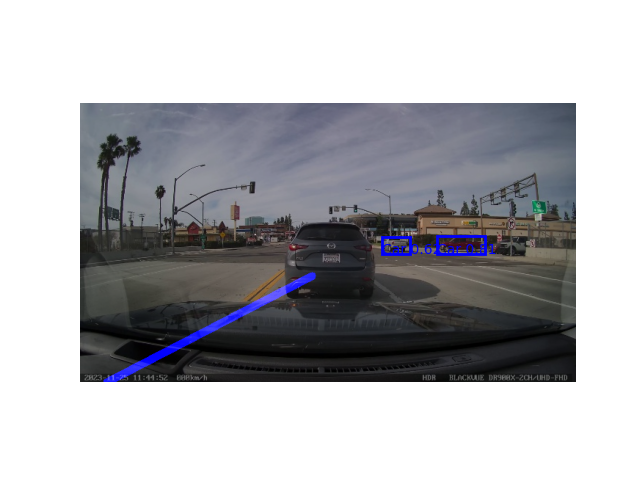

Cannot draw slope line !


[2023-12-04 19:34:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


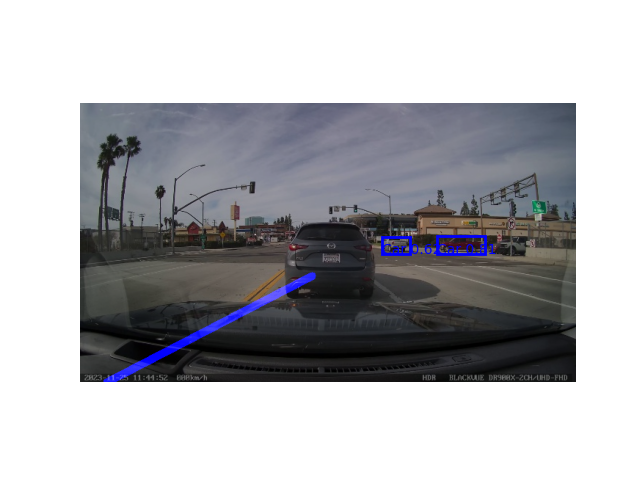

84/486
Cannot draw slope line !


[2023-12-04 19:34:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


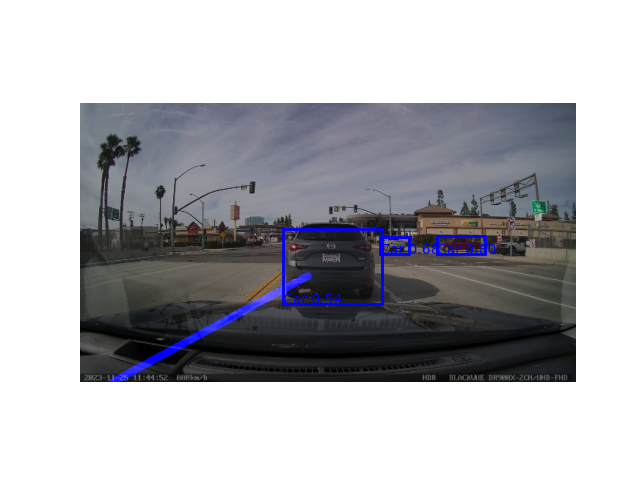

Cannot draw slope line !


[2023-12-04 19:34:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


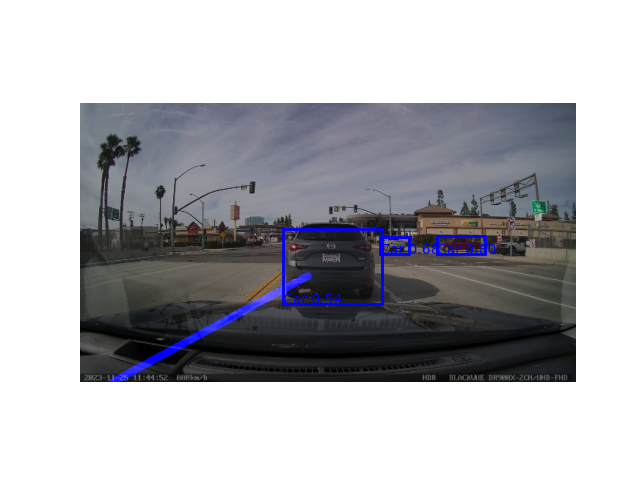

85/486
Cannot draw slope line !


[2023-12-04 19:34:20] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


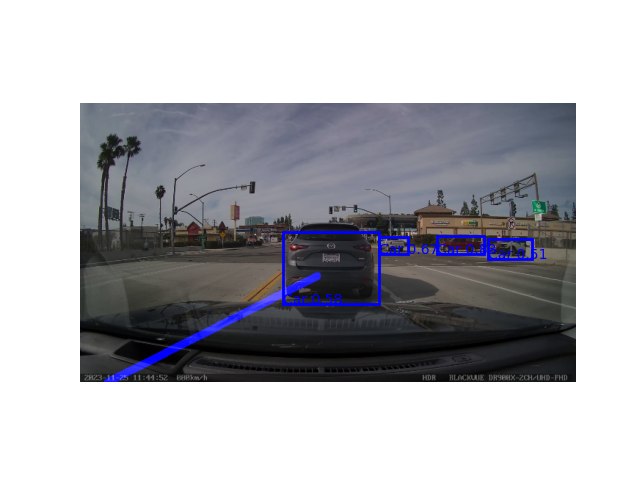

Cannot draw slope line !


In [ ]:
# display result
files = glob.glob(f"/kaggle/input/frames/vid5_frames/*")
for i in range(len(files)):
    print(f"{i}/{len(files)}")
    file = f'/kaggle/input/frames/vid5_frames/frame{i}.jpg'
    frame_processor(cv2.imread(file), best_model)
    cv2.imwrite(f'/kaggle/working/vid5_frames/processed_frame{i}.jpg', frame_processor(cv2.imread(file), best_model))

In [ ]:
!zip -r file.zip /kaggle/working
!ls

In [ ]:
from IPython.display import FileLink
FileLink(r'file.zip')